# ----------------------------Applied Data Science Projet:ETF --------------------------------

### Importing required libraries

In [1]:
%%time
import matplotlib.pyplot as plt
import pandas as pd
import datetime
import numpy as np
import plotly.graph_objects as go
import sys
from tqdm import tqdm
import seaborn as sns

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (16, 10) # increase the size of graphs
mpl.rcParams['legend.fontsize'] = 12
mpl.rcParams['lines.linewidth'] = 1

%matplotlib inline
from datetime import datetime
import plotly.express as px

from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn import manifold

from sklearn.linear_model import LinearRegression,LassoCV,RidgeCV,Ridge,Lasso
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense,LSTM

import cvxpy as cp
from sklearn.model_selection import train_test_split


Wall time: 20.1 s


## Functions 

In [2]:
%%time
# Risk measure functions 

# Volatility
def calculate_vol(returns):
    return np.std(returns)

# Value at Risk conditionnel
def calculate_var(returns):
    return np.percentile(returns, 100 * 0.005)

# Maximum Drawdown des rendements cumulatifs non composés (Ratio de Calmar)
def calculate_mdd(returns):
    cum_returns = np.cumprod(1 + returns) - 1
    return np.max(np.maximum.accumulate(cum_returns) - cum_returns)

Wall time: 0 ns


In [3]:
%%time
# this function is to identify the high correlation 

def High_Cor(df,var,dfcor):
    noms_var = list(df.columns)
    nom_var_reference = var
    noms_var_corr_sup_09 = [nom_colonne 
                            for nom_colonne in dfcor.columns 
                            if dfcor.loc[nom_var_reference, nom_colonne] > 0.95
                            and nom_colonne != nom_var_reference]
    noms_var_corr_sup_09.append(var)
    return noms_var_corr_sup_09


# This function gives information about what stock is in etf 
def ClusterInfo(df,nb):
    return df.query('Cluster=='+str(nb))


Wall time: 0 ns


### Database

In [4]:
%%time
df1=pd.read_csv('ETF_Universe.csv',sep=',',index_col='Date')
df2=pd.read_csv('Macro_Factors.csv',sep=',',index_col='Date')
df3=pd.read_csv('Mystery_Allocation.csv',sep=';',index_col='Date')
df4=pd.read_csv('Mystery_Allocation_v2.csv',sep=';',index_col='Date')

Wall time: 84.4 ms


In [5]:
%%time
df = pd.merge(df1, df2, on='Date', how='inner')

Wall time: 10.9 ms


In [6]:
df

,ETF_1,ETF_2,ETF_3,ETF_4,ETF_5,ETF_6,ETF_7,ETF_8,ETF_9,ETF_10,...,Japan Nikkei 225,MSCI EM USD,US HY,EU HY,BCOM Energy,BCOM Industrial Metals,BCOM Gold,Dollar Index,US 10Y Bond,Germany Bund 10Y
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,...,45047.04,630.517,318.0612,207.4194,20.2183,135.4156,216.1090,1040.289,1182.058,1790.415
2021-01-05,100.664447,100.083922,99.252395,102.032069,100.041029,100.269482,99.779466,101.721018,99.633393,100.025174,...,44882.19,638.034,318.1225,207.4808,21.1276,137.4571,216.9749,1043.137,1178.733,1788.087
2021-01-06,98.549788,99.519065,98.364484,107.519936,99.698544,99.834420,101.532557,101.561550,99.624949,100.121489,...,44712.49,635.789,318.4568,207.6067,21.3284,138.1451,211.8903,1039.544,1171.182,1775.302
2021-01-07,99.735901,98.684154,99.717292,114.954919,101.233032,101.019559,103.712486,104.576537,99.222455,100.238511,...,45430.03,639.180,318.7039,207.7834,21.3946,139.5059,212.4454,1043.476,1168.254,1778.542
2021-01-08,101.813931,101.323378,99.264960,116.151961,103.332426,103.120770,104.025163,105.525583,95.806184,100.473455,...,46502.40,654.287,318.8697,207.9640,21.6744,137.6681,203.7637,1043.282,1164.786,1778.409
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-23,74.868592,113.657686,121.902518,68.095661,106.478710,86.832247,90.525182,117.126901,82.487299,99.325409,...,47135.61,498.360,302.7537,197.9170,31.9448,157.4597,212.0417,1199.509,967.847,1275.453
2023-03-24,75.202682,111.067955,119.537197,67.401513,106.473096,86.952706,90.170160,115.425105,83.089632,99.410211,...,47076.54,495.640,301.4518,197.5785,31.9028,157.8276,210.8200,1210.312,969.057,1302.301
2023-03-27,74.952348,111.341238,121.790482,67.562456,106.564655,86.510194,90.180661,114.424591,83.051635,98.971767,...,47234.21,491.570,301.6986,197.8065,32.5105,158.9371,207.6393,1208.977,958.155,1278.860


### Data visualization

In [7]:
%%time
# We selected some ETFs and main asset to plot some graph
etf_graph=[ 'ETF_1','ETF_2','ETF_3','ETF_4','ETF_5',
            'ETF_96','ETF_97','ETF_98','ETF_99','ETF_100','US S&P 500', 
            'EU Stoxx 600', 'Japan Nikkei 225', 'MSCI EM USD',
            'US HY', 'EU HY', 'BCOM Energy', 'BCOM Industrial Metals', 'BCOM Gold',
            'Dollar Index', 'US 10Y Bond', 'Germany Bund 10Y']

Wall time: 0 ns


In [8]:
%%time
fig = px.line(df[etf_graph]/df[etf_graph].iloc[0,:], template='plotly_white')
fig.show()

Wall time: 2.22 s


Wall time: 782 ms


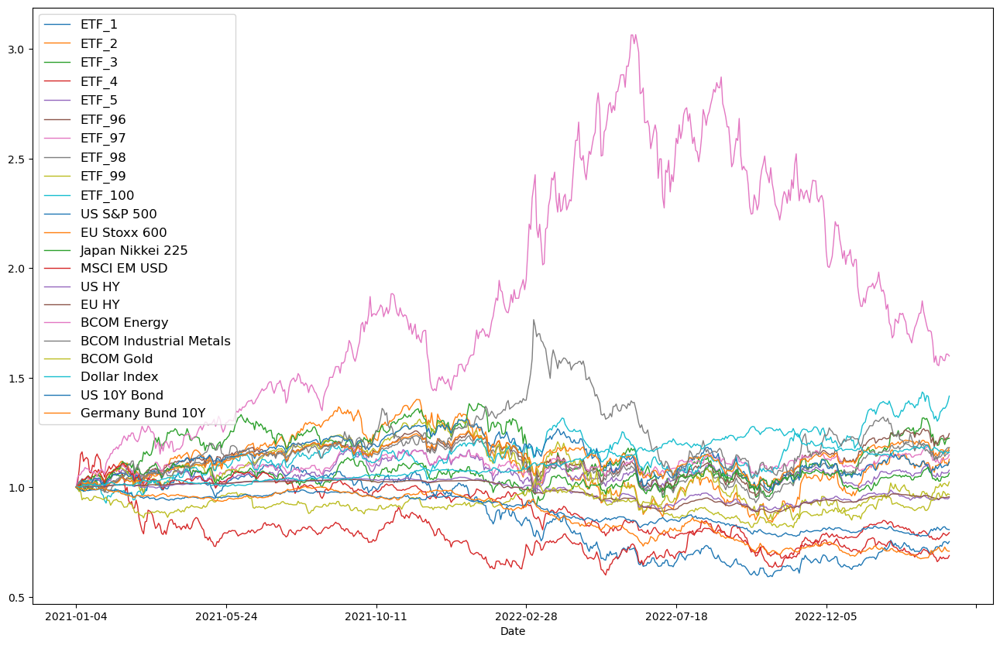

In [9]:
%%time
ax1 = (df[etf_graph]/df[etf_graph].iloc[0,:]).plot()
plt.savefig('evolution.png', format='png')

In [10]:
%%time
# Calculating returns
ret = df.pct_change().dropna()
display(ret.head())

,ETF_1,ETF_2,ETF_3,ETF_4,ETF_5,ETF_6,ETF_7,ETF_8,ETF_9,ETF_10,...,Japan Nikkei 225,MSCI EM USD,US HY,EU HY,BCOM Energy,BCOM Industrial Metals,BCOM Gold,Dollar Index,US 10Y Bond,Germany Bund 10Y
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-05,0.006644,0.000839,-0.007476,0.020321,0.000410,0.002695,-0.002205,0.017210,-0.003666,0.000252,...,-0.003660,0.011922,0.000193,0.000296,0.044974,0.015076,0.004007,0.002738,-0.002813,-0.001300
2021-01-06,-0.021007,-0.005644,-0.008946,0.053786,-0.003423,-0.004339,0.017570,-0.001568,-0.000085,0.000963,...,-0.003781,-0.003519,0.001051,0.000607,0.009504,0.005005,-0.023434,-0.003444,-0.006406,-0.007150
2021-01-07,0.012036,-0.008389,0.013753,0.069150,0.015391,0.011871,0.021470,0.029686,-0.004040,0.001169,...,0.016048,0.005334,0.000776,0.000851,0.003104,0.009851,0.002620,0.003782,-0.002500,0.001825
2021-01-08,0.020835,0.026744,-0.004536,0.010413,0.020738,0.020800,0.003015,0.009075,-0.034430,0.002344,...,0.023605,0.023635,0.000520,0.000869,0.013078,-0.013174,-0.040866,-0.000186,-0.002969,-0.000075
2021-01-11,-0.005786,-0.006955,-0.011561,-0.037496,0.000100,-0.004797,-0.013355,0.005214,-0.027116,-0.002339,...,0.000000,-0.002905,-0.001332,0.000239,0.004023,-0.022291,0.008365,0.009673,-0.002344,-0.002650


Wall time: 31 ms


In [112]:
%%time
#return 
fig = px.line(ret[etf_graph], template='plotly_white')
fig.show()

Wall time: 781 ms


Wall time: 570 ms


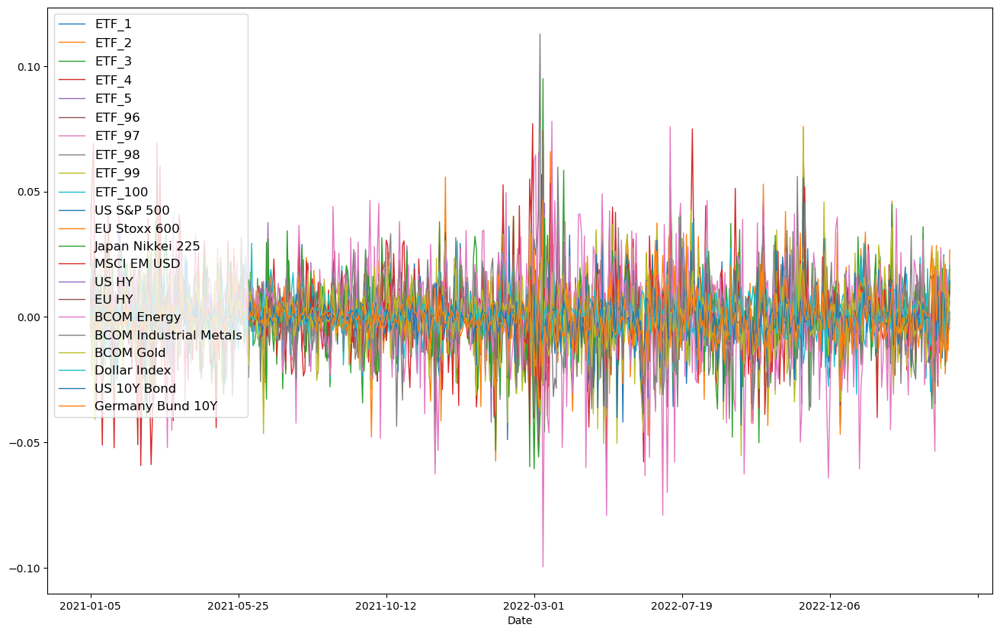

In [12]:
%%time
ax1 = (ret[etf_graph]).plot()
plt.savefig('return.png', format='png')

## Classification of ETFs 

### Clustering by risks measures 

In this part we compute 3 risks measures for each 100 days in order to have a moving values

In [13]:
%%time
#Initializing the dataframe
df_vol=pd.DataFrame({'ETF':list(df1.columns)})
df_mdd=pd.DataFrame({'ETF':list(df1.columns)})
df_VaR=pd.DataFrame({'ETF':list(df1.columns)})

Wall time: 1 ms


In [14]:
%%time
# Benchemark
Ben = ['US S&P 500', 
            'EU Stoxx 600', 'Japan Nikkei 225', 'MSCI EM USD',
            'US HY', 'EU HY', 'BCOM Energy', 'BCOM Industrial Metals', 'BCOM Gold',
            'Dollar Index', 'US 10Y Bond', 'Germany Bund 10Y']

Wall time: 0 ns


In [15]:
%%time
for j in range(0,483):
    df_vol['vol'+str(j)]=list(calculate_vol(ret.drop(columns=Ben).iloc[0+j:101+j,: ]))

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

Wall time: 747 ms


<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:2: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

In [16]:
%%time
for j in range(0,483):
    l=[]
    for i in range(101):
        l.append(calculate_var(ret.drop(columns=Ben).iloc[0+j:101+j,i]))
    df_VaR['VaR'+str(j)]=l

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

Wall time: 33.8 s


<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [17]:
%%time
for j in range(0,483):
    l=[]
    for i in range(101):
        l.append(calculate_mdd(ret.drop(columns=Ben).iloc[0+j:101+j,i]))
    df_mdd['mdd'+str(j)]=l

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.

Wall time: 49.7 s


<timed exec>:5: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [18]:
%%time
df_vol=df_vol.set_index('ETF')
df_VaR=df_VaR.set_index('ETF')
df_mdd=df_mdd.set_index('ETF')

Wall time: 17.6 ms


In [19]:
%%time
df_vol

Wall time: 0 ns


,vol0,vol1,vol2,vol3,vol4,vol5,vol6,vol7,vol8,vol9,...,vol473,vol474,vol475,vol476,vol477,vol478,vol479,vol480,vol481,vol482
ETF,,,,,,,,,,,,,,,,,,,,,
ETF_1,0.013018,0.013023,0.012848,0.012811,0.012656,0.012641,0.012645,0.012655,0.012656,0.012543,...,0.015861,0.015847,0.015868,0.015885,0.015927,0.015841,0.015849,0.015853,0.015892,0.015540
ETF_2,0.014143,0.014144,0.014129,0.014138,0.013929,0.013910,0.013903,0.013927,0.013860,0.013762,...,0.017300,0.017272,0.017268,0.017252,0.017294,0.017295,0.017130,0.017152,0.017042,0.017082
ETF_3,0.013832,0.013806,0.013834,0.013799,0.013784,0.013859,0.013817,0.013811,0.013743,0.013577,...,0.014738,0.014724,0.014841,0.014830,0.014795,0.014701,0.014374,0.014328,0.014326,0.014363
ETF_4,0.025661,0.025605,0.024989,0.023954,0.023915,0.023673,0.023660,0.023678,0.023695,0.023218,...,0.013661,0.013691,0.013867,0.013913,0.013930,0.013927,0.013923,0.013914,0.013863,0.013932
ETF_5,0.010848,0.010849,0.010849,0.010913,0.010781,0.010781,0.010785,0.010796,0.010790,0.010762,...,0.008804,0.008888,0.008792,0.008958,0.008962,0.008962,0.008815,0.008747,0.008669,0.008677
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ETF_97,0.010155,0.010152,0.010159,0.010179,0.010132,0.010132,0.010161,0.010188,0.010176,0.010137,...,0.008238,0.008357,0.008193,0.008376,0.008386,0.008387,0.008279,0.008218,0.008227,0.008254
ETF_98,0.007831,0.007816,0.007718,0.007734,0.007747,0.007727,0.007728,0.007730,0.007717,0.007609,...,0.010291,0.010340,0.010441,0.010423,0.010386,0.010510,0.010283,0.010276,0.010332,0.010379
ETF_99,0.014126,0.014107,0.014036,0.013827,0.013774,0.013684,0.013683,0.013717,0.013808,0.013785,...,0.017033,0.016760,0.016760,0.016786,0.016453,0.016313,0.016278,0.016264,0.016342,0.016227


### PCA and Hierarchical Clustering for risks measure

In this part we evaluate the  PCA in order to detect our cluster 

#### Volatility PCA

In [20]:
#initialazing the PCA with 2 components
pca_ = PCA(n_components=2)

In [21]:
#Fit the PCA
PCA=pca_.fit(df_vol)

In [22]:
#Display PCA results
display(PCA.explained_variance_ratio_,
        PCA.explained_variance_,
        PCA.singular_values_)

array([0.76876654, 0.17539286])

array([0.01544054, 0.00352274])

array([1.24259985, 0.59352636])

In [23]:
#Fit the model with df_vol and apply the dimensionality reduction on df_vol.
mvts_2D_=PCA.fit_transform(df_vol)

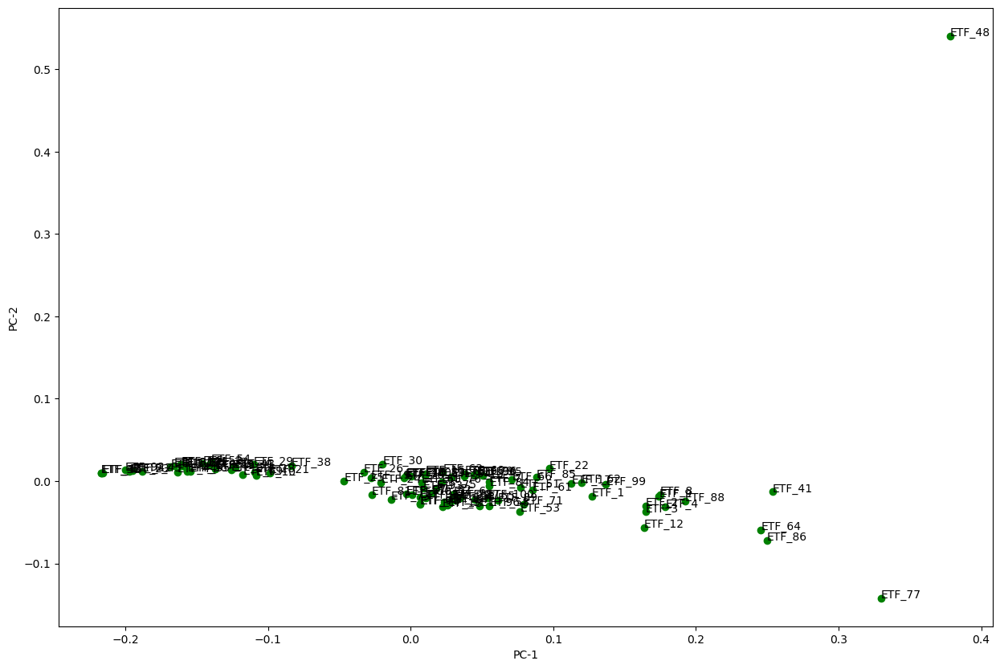

<Figure size 1600x1000 with 0 Axes>

In [24]:
# Plot the result 
fig = plt.figure(figsize=(15, 10))

for n in range(len(ret.drop(columns=Ben).columns)):
    x = mvts_2D_[n, 0]
    y = mvts_2D_[n, 1]
    asset = ret.drop(columns=Ben).columns[n]
    plt.scatter(x, y, c="g")
    plt.text(x, y, asset, fontsize=10,)
plt.xlabel("PC-1")
plt.ylabel("PC-2")
plt.show()
plt.savefig('FigPCA1.png', format='png')

In [25]:
# Plot the result with plotly
df_vol["PC-1"] = mvts_2D_[:, 0]
df_vol["PC-2"] = mvts_2D_[:, 1]

fig = px.scatter(df_vol, x="PC-1", y="PC-2", text=df_vol.index,
                 color_discrete_sequence=["green"], size_max=10,template='plotly_white')

fig.update_traces(textposition='top center', textfont_size=10)

fig.update_layout(title="PCA Projection of Assets",
                  xaxis_title="PC-1", yaxis_title="PC-2",
                  width=1000, height=800)
fig.show()

### Hierarchical Clustering

#### Volatility

In [26]:
df_vol

,vol0,vol1,vol2,vol3,vol4,vol5,vol6,vol7,vol8,vol9,...,vol475,vol476,vol477,vol478,vol479,vol480,vol481,vol482,PC-1,PC-2
ETF,,,,,,,,,,,,,,,,,,,,,
ETF_1,0.013018,0.013023,0.012848,0.012811,0.012656,0.012641,0.012645,0.012655,0.012656,0.012543,...,0.015868,0.015885,0.015927,0.015841,0.015849,0.015853,0.015892,0.015540,0.126880,-0.018513
ETF_2,0.014143,0.014144,0.014129,0.014138,0.013929,0.013910,0.013903,0.013927,0.013860,0.013762,...,0.017268,0.017252,0.017294,0.017295,0.017130,0.017152,0.017042,0.017082,0.164866,-0.030084
ETF_3,0.013832,0.013806,0.013834,0.013799,0.013784,0.013859,0.013817,0.013811,0.013743,0.013577,...,0.014841,0.014830,0.014795,0.014701,0.014374,0.014328,0.014326,0.014363,0.164569,-0.037391
ETF_4,0.025661,0.025605,0.024989,0.023954,0.023915,0.023673,0.023660,0.023678,0.023695,0.023218,...,0.013867,0.013913,0.013930,0.013927,0.013923,0.013914,0.013863,0.013932,0.178564,-0.031448
ETF_5,0.010848,0.010849,0.010849,0.010913,0.010781,0.010781,0.010785,0.010796,0.010790,0.010762,...,0.008792,0.008958,0.008962,0.008962,0.008815,0.008747,0.008669,0.008677,0.025896,-0.029625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ETF_97,0.010155,0.010152,0.010159,0.010179,0.010132,0.010132,0.010161,0.010188,0.010176,0.010137,...,0.008193,0.008376,0.008386,0.008387,0.008279,0.008218,0.008227,0.008254,0.006531,-0.027625
ETF_98,0.007831,0.007816,0.007718,0.007734,0.007747,0.007727,0.007728,0.007730,0.007717,0.007609,...,0.010441,0.010423,0.010386,0.010510,0.010283,0.010276,0.010332,0.010379,0.031182,-0.023393
ETF_99,0.014126,0.014107,0.014036,0.013827,0.013774,0.013684,0.013683,0.013717,0.013808,0.013785,...,0.016760,0.016786,0.016453,0.016313,0.016278,0.016264,0.016342,0.016227,0.136895,-0.004271


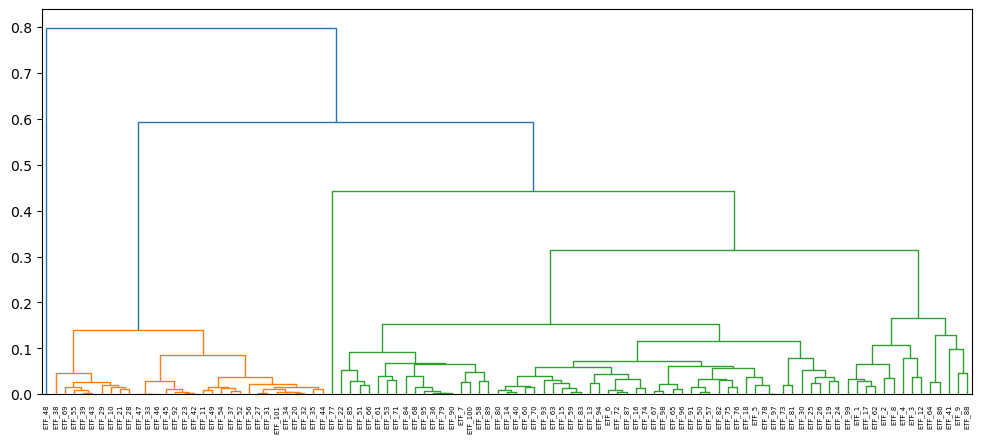

In [27]:
# The Dendrogram
plt.figure(figsize=(12,5))
Z = linkage(df_vol.drop(columns=['PC-1','PC-2']), method='complete', metric='euclidean')

'''
The linkage() function is called to perform linkage analysis on the df_vol data. 
This linkage analysis computes a distance matrix between all pairs of data points, 
and then groups the points based on their proximity using a hierarchical agglomerative clustering algorithm.

The parameters of the linkage() function are defined as follow:
- df_vol.

- method='complete' indicates that the complete linking method is used to group the points. 
          This method calculates the maximum distance between points in two groups to determine the distance 
          between the groups.
          
- metric='euclidean' indicates that the Euclidean distance is used to calculate the distance between points.
'''
#plot of the  dendrogram
dendrogram(Z, labels=df_vol.index, orientation='top', 
           leaf_rotation=90);
'''
The dendrogram() function is called to draw the dendrogram. The parameters of this function are the following:

- Z is the linkage matrix created previously by the linkage() function.
- labels=df_vol.index specifies the labels for each data point in the order they appear in df_vol.
- orientation='top' specifies that the dendrogram will be oriented horizontally.
- leaf_rotation=90 specifies the rotation angle of the leaf labels.
'''

plt.savefig('dendogram_vol.png', format='png')

In [28]:
# Clusterize the data
threshold = 0.5
labels = fcluster(Z, threshold, criterion='distance',depth=4)

'''
- Z is the linkage matrix created previously by the linkage() function.
- threshold is the cutoff threshold for grouping the points into clusters.
- criterion='distance' indicates that the threshold is based on the distance between the data points.
- depth=4 limits the depth of the hierarchy to avoid having too many clusters.

'''
# Show the cluster
labels

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2,
       1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 2, 1, 1, 1,
       1, 1, 1, 3, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1], dtype=int32)

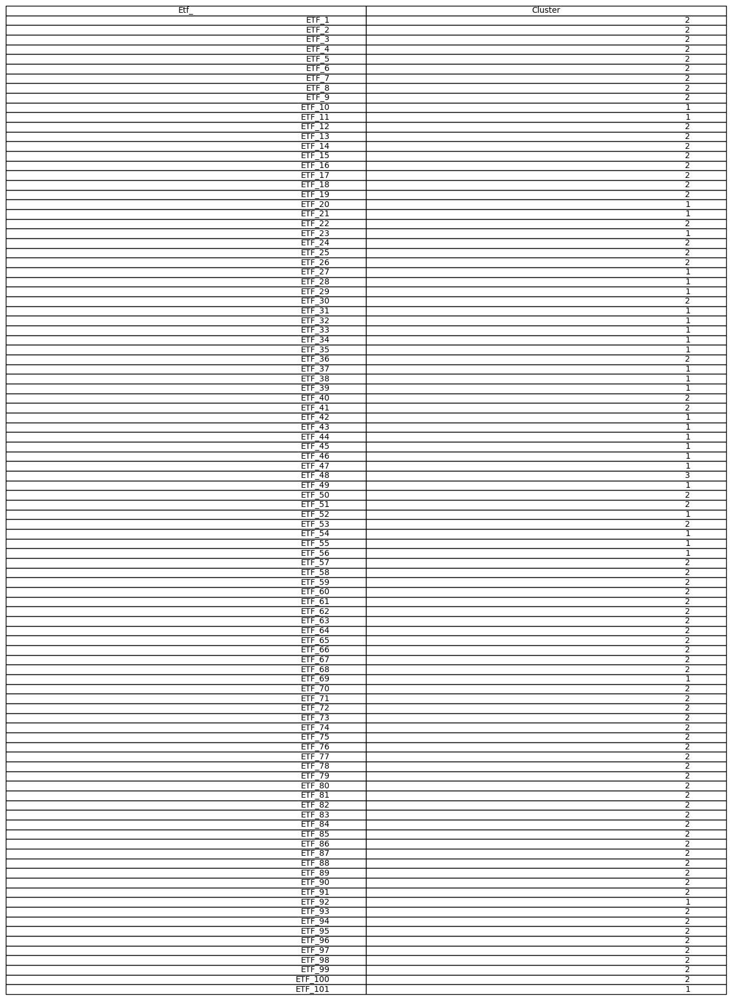

In [29]:
# to plot the table of ETFs clustering with HAC
dict={'Etf_':list(df_vol.drop(columns=['PC-1','PC-2']).T.columns),
      'Cluster':list(labels)}

df_clus=pd.DataFrame(dict)
df_clus

# Tracer le DataFrame sous forme de table
ax = plt.subplot(111, frame_on=False)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
table = plt.table(cellText=df_clus.values, colLabels=df_clus.columns, loc='center')
table.auto_set_font_size(True)
table.set_fontsize(10)
table.scale(1, 1)

# Enregistrer l'image en PNG
plt.savefig('TabClusterCAH_vol.png', bbox_inches='tight', pad_inches=0)

In [30]:
# Number of ETFs in each cluster
df_clus['Cluster'].value_counts()

2    70
1    30
3     1
Name: Cluster, dtype: int64

We can use both ClusterInfo and High_Corr to identify the etf in both sample of varriable

In [31]:
# List of ETFs in each cluster
for i in range(1,4):
    display(ClusterInfo(df_clus,i))

,Etf_,Cluster
9,ETF_10,1
10,ETF_11,1
19,ETF_20,1
20,ETF_21,1
22,ETF_23,1
26,ETF_27,1
27,ETF_28,1
28,ETF_29,1
30,ETF_31,1
31,ETF_32,1


,Etf_,Cluster
0,ETF_1,2
1,ETF_2,2
2,ETF_3,2
3,ETF_4,2
4,ETF_5,2
...,...,...
95,ETF_96,2
96,ETF_97,2
97,ETF_98,2
98,ETF_99,2


,Etf_,Cluster
47,ETF_48,3


#### Comments

#### Value at Risk (VaR) PCA

In [32]:
from sklearn.decomposition import PCA
pca_ = PCA(n_components=2)

In [33]:
PCA_=pca_.fit(df_VaR)

In [34]:
display(PCA_.explained_variance_ratio_,
        PCA_.singular_values_)

array([0.72414849, 0.19454876])

array([3.2725549 , 1.69624023])

In [35]:
mvts_2D_=PCA_.fit_transform(df_VaR)

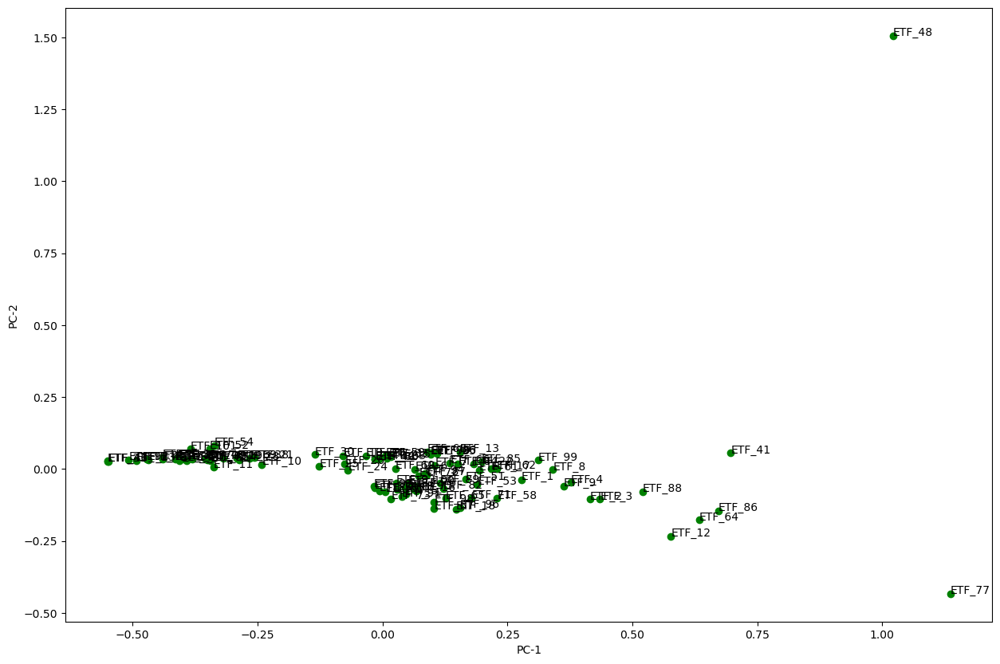

<Figure size 1600x1000 with 0 Axes>

In [36]:
fig = plt.figure(figsize=(15, 10))  # figsize=(20, 20)

for n in range(len(ret.drop(columns=Ben).columns)):
    x = mvts_2D_[n, 0]
    y = mvts_2D_[n, 1]
    asset = ret.drop(columns=Ben).columns[n]
    plt.scatter(x, y, c="g")
    plt.text(x, y, asset, fontsize=10,)  # alpha=0.5)
plt.xlabel("PC-1")
plt.ylabel("PC-2")
plt.show()
plt.savefig('FigPCA2.png', format='png')

In [37]:
df_VaR["PC-1"] = mvts_2D_[:, 0]
df_VaR["PC-2"] = mvts_2D_[:, 1]

fig = px.scatter(df_VaR, x="PC-1", y="PC-2", text=df_vol.index,
                 color_discrete_sequence=["green"], size_max=10,template='plotly_white')
fig.update_traces(textposition='top center', textfont_size=10)
fig.update_layout(title="PCA Projection of Assets",
                  xaxis_title="PC-1", yaxis_title="PC-2",
                  width=1000, height=800)
fig.show()

#### Value at Risk (VaR) HAC

In [38]:
df_VaR

,VaR0,VaR1,VaR2,VaR3,VaR4,VaR5,VaR6,VaR7,VaR8,VaR9,...,VaR475,VaR476,VaR477,VaR478,VaR479,VaR480,VaR481,VaR482,PC-1,PC-2
ETF,,,,,,,,,,,,,,,,,,,,,
ETF_1,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,-0.029937,...,-0.039028,-0.039028,-0.039028,-0.039028,-0.039028,-0.039028,-0.039028,-0.033868,0.277849,-0.037759
ETF_2,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,-0.035199,...,-0.038100,-0.038100,-0.038100,-0.038100,-0.038100,-0.038100,-0.038100,-0.038188,0.415278,-0.105281
ETF_3,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,-0.030275,...,-0.036949,-0.036949,-0.036949,-0.036949,-0.036949,-0.036949,-0.036949,-0.036952,0.435254,-0.104911
ETF_4,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,-0.059093,...,-0.033901,-0.033901,-0.033901,-0.033901,-0.033901,-0.033901,-0.033901,-0.033963,0.377357,-0.046662
ETF_5,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,-0.032264,...,-0.020579,-0.020579,-0.020579,-0.020579,-0.020579,-0.020579,-0.020579,-0.020591,0.046601,-0.087075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ETF_97,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,-0.029002,...,-0.022924,-0.022924,-0.022924,-0.022924,-0.022924,-0.022924,-0.022924,-0.022954,-0.017336,-0.060687
ETF_98,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,-0.018215,...,-0.032014,-0.032014,-0.032014,-0.032014,-0.032014,-0.032014,-0.032014,-0.032028,0.103394,-0.114634
ETF_99,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,-0.033449,...,-0.033811,-0.033811,-0.029313,-0.029313,-0.029313,-0.029313,-0.029313,-0.029357,0.311953,0.030539


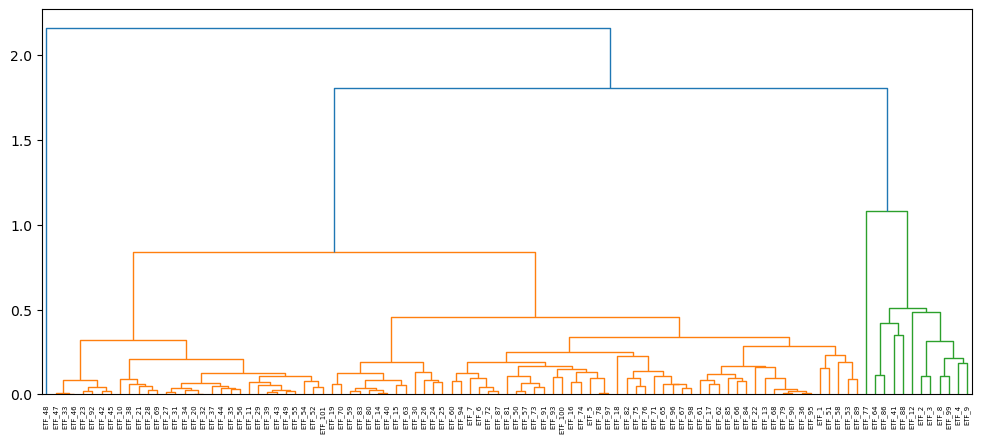

In [39]:
plt.figure(figsize=(12,5))
Z = linkage(df_VaR.drop(columns=['PC-1','PC-2']), method='complete', metric='euclidean')

dendrogram(Z, labels=df_vol.index, orientation='top', 
           leaf_rotation=90);
plt.savefig('dendogram_var.png', format='png')

In [40]:
# Clusterize the data
threshold = 0.8
labels = fcluster(Z, threshold, criterion='distance',depth=2)

# Show the cluster
labels

array([2, 3, 3, 3, 2, 2, 2, 3, 3, 1, 1, 3, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2,
       1, 2, 2, 2, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1, 1, 1, 2, 3, 1, 1, 1,
       1, 1, 1, 5, 1, 2, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2,
       2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 4, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3,
       2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 3, 2, 1], dtype=int32)

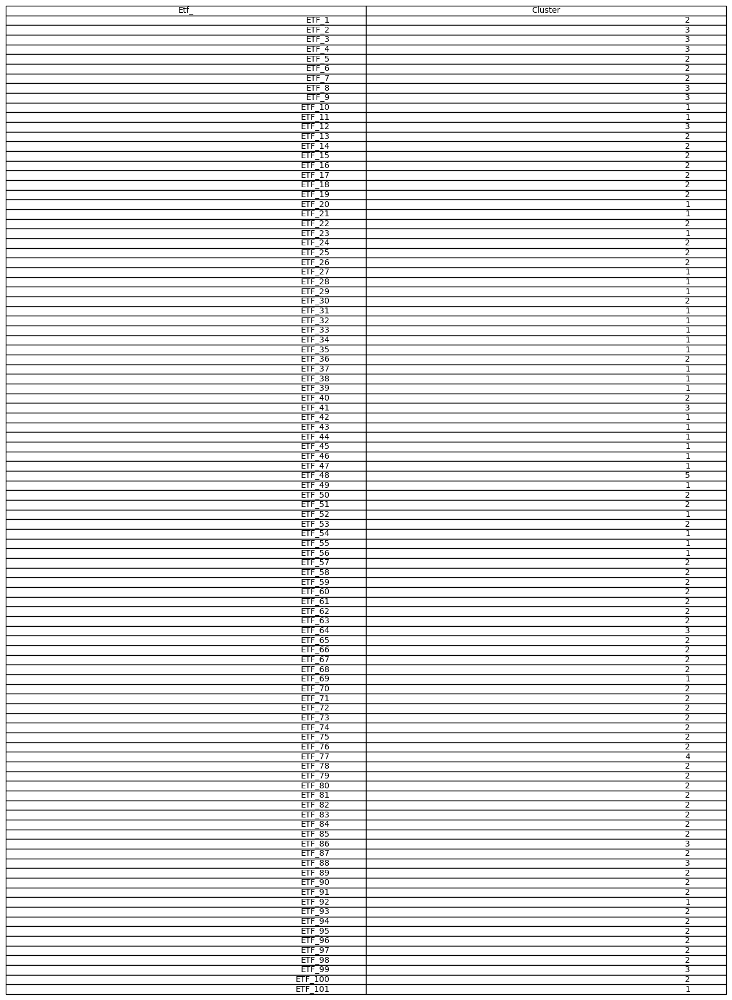

In [41]:
dict={'Etf_':list(df_VaR.drop(columns=['PC-1','PC-2']).T.columns),
      'Cluster':list(labels)}

df_clus=pd.DataFrame(dict)
df_clus

# Tracer le DataFrame sous forme de table
ax = plt.subplot(111, frame_on=False)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
table = plt.table(cellText=df_clus.values, colLabels=df_clus.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1)

# Enregistrer l'image en PNG
plt.savefig('TabClusterCAH_vol.png', bbox_inches='tight', pad_inches=0)

In [42]:
df_clus['Cluster'].value_counts()

2    58
1    30
3    11
5     1
4     1
Name: Cluster, dtype: int64

We can use both ClusterInfo and High_Corr to identify the etf in both sample of varriable

In [43]:
for i in range(1,6):
    display(ClusterInfo(df_clus,i))

,Etf_,Cluster
9,ETF_10,1
10,ETF_11,1
19,ETF_20,1
20,ETF_21,1
22,ETF_23,1
26,ETF_27,1
27,ETF_28,1
28,ETF_29,1
30,ETF_31,1
31,ETF_32,1


,Etf_,Cluster
0,ETF_1,2
4,ETF_5,2
5,ETF_6,2
6,ETF_7,2
12,ETF_13,2
13,ETF_14,2
14,ETF_15,2
15,ETF_16,2
16,ETF_17,2
17,ETF_18,2


,Etf_,Cluster
1,ETF_2,3
2,ETF_3,3
3,ETF_4,3
7,ETF_8,3
8,ETF_9,3
11,ETF_12,3
40,ETF_41,3
63,ETF_64,3
85,ETF_86,3
87,ETF_88,3


,Etf_,Cluster
76,ETF_77,4


,Etf_,Cluster
47,ETF_48,5


#### Comments

#### MDD PCA

In [44]:
df_mdd

,mdd0,mdd1,mdd2,mdd3,mdd4,mdd5,mdd6,mdd7,mdd8,mdd9,...,mdd473,mdd474,mdd475,mdd476,mdd477,mdd478,mdd479,mdd480,mdd481,mdd482
ETF,,,,,,,,,,,,,,,,,,,,,
ETF_1,0.158511,0.157465,0.160843,0.158931,0.155687,0.156593,0.156360,0.156185,0.157400,0.160068,...,0.103690,0.102658,0.103210,0.103040,0.104966,0.106549,0.106502,0.105171,0.104814,0.108598
ETF_2,0.115500,0.115403,0.116058,0.117040,0.113991,0.114790,0.114066,0.113694,0.111583,0.113352,...,0.127223,0.128297,0.128542,0.127302,0.129005,0.132004,0.128624,0.126765,0.122665,0.123971
ETF_3,0.100592,0.101349,0.102264,0.100877,0.101336,0.102522,0.100774,0.101762,0.100089,0.102050,...,0.120427,0.121043,0.120565,0.119533,0.120744,0.123870,0.119441,0.117890,0.117480,0.118499
ETF_4,0.431264,0.422675,0.401101,0.375159,0.363034,0.377177,0.373002,0.371214,0.374192,0.394369,...,0.160891,0.161887,0.161597,0.160723,0.161996,0.160273,0.159654,0.160482,0.156961,0.157105
ETF_5,0.091162,0.091125,0.091438,0.090052,0.088222,0.088214,0.087918,0.087684,0.087336,0.088002,...,0.090988,0.091578,0.090382,0.089665,0.089299,0.089291,0.090751,0.089744,0.088335,0.089012
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ETF_97,0.079262,0.079410,0.079306,0.077955,0.076674,0.076674,0.076511,0.076257,0.075837,0.076474,...,0.083079,0.083372,0.082008,0.081552,0.081461,0.081461,0.082588,0.081709,0.080658,0.081022
ETF_98,0.041750,0.041916,0.041351,0.041156,0.040460,0.040765,0.040782,0.040712,0.036187,0.036626,...,0.076503,0.076499,0.076369,0.075810,0.076387,0.077098,0.075252,0.074893,0.074229,0.074348
ETF_99,0.118484,0.117480,0.119146,0.116233,0.114763,0.116566,0.116660,0.115927,0.116600,0.117463,...,0.121626,0.117882,0.119336,0.120569,0.124798,0.127316,0.125331,0.123961,0.123034,0.126003


In [45]:
 _pca_ = PCA(n_components=2)

In [46]:
PCA_=_pca_.fit(df_mdd)

In [47]:
display(PCA_.explained_variance_ratio_,
        PCA_.singular_values_)

array([0.70840383, 0.13286682])

array([13.67666506,  5.92308579])

In [48]:
mvts_2D_=PCA_.fit_transform(df_mdd)

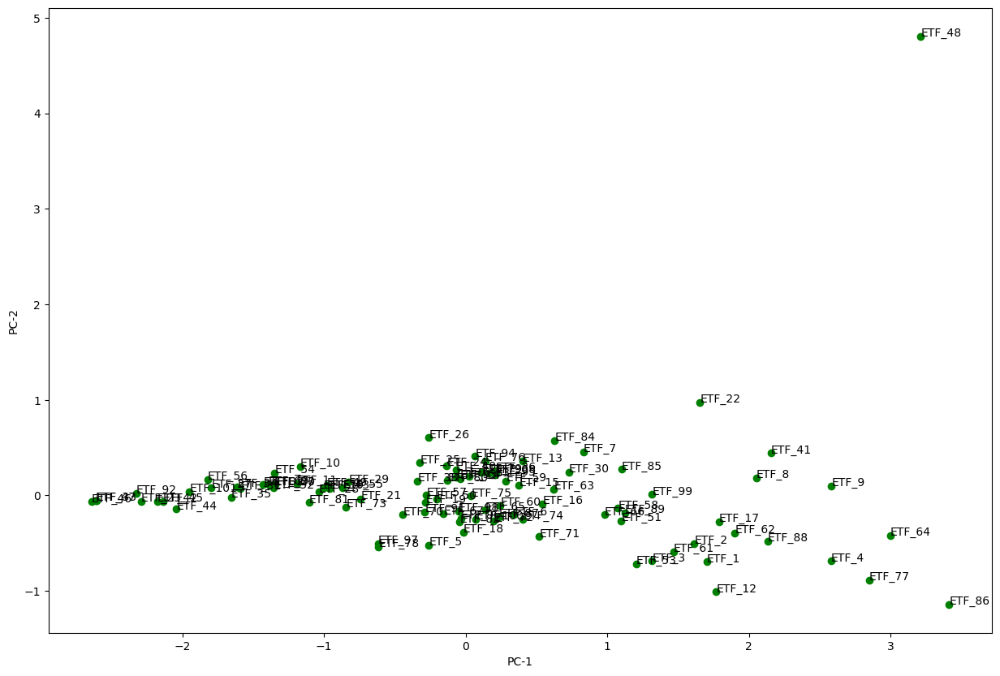

<Figure size 1600x1000 with 0 Axes>

In [49]:
fig = plt.figure(figsize=(15, 10))  # figsize=(20, 20)

for n in range(len(ret.drop(columns=Ben).columns)):
    x = mvts_2D_[n, 0]
    y = mvts_2D_[n, 1]
    asset = ret.drop(columns=Ben).columns[n]
    plt.scatter(x, y, c="g")
    plt.text(x, y, asset, fontsize=10,)  # alpha=0.5)
plt.xlabel("PC-1")
plt.ylabel("PC-2")
plt.show()
plt.savefig('FigPCA2.png', format='png')

In [50]:
df_mdd["PC-1"] = mvts_2D_[:, 0]
df_mdd["PC-2"] = mvts_2D_[:, 1]

fig = px.scatter(df_mdd, x="PC-1", y="PC-2", text=df_vol.index,
                 color_discrete_sequence=["green"], size_max=10,template='plotly_white')
fig.update_traces(textposition='top center', textfont_size=10)
fig.update_layout(title="PCA Projection of Assets",
                  xaxis_title="PC-1", yaxis_title="PC-2",
                  width=1000, height=800)
fig.show()

#### MDD HAC

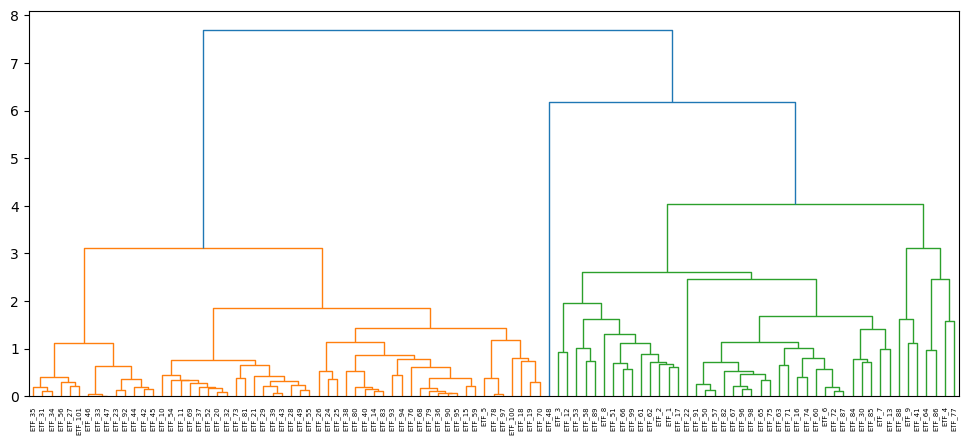

In [51]:
plt.figure(figsize=(12,5))
Z = linkage(df_mdd.drop(columns=['PC-1','PC-2']), method='complete', metric='euclidean')

dendrogram(Z, labels=df_vol.index, orientation='top', 
           leaf_rotation=90);
plt.savefig('dendogram_mdd.png', format='png')

In [52]:
# Clusterize the data
threshold = 3
labels = fcluster(Z, threshold, criterion='distance',depth=2)

# Show the cluster
labels

array([3, 3, 3, 5, 2, 3, 3, 3, 4, 2, 2, 3, 3, 2, 2, 3, 3, 2, 2, 2, 2, 3,
       1, 2, 2, 2, 1, 2, 2, 3, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 4, 1, 2, 1,
       1, 1, 1, 6, 2, 3, 3, 2, 3, 2, 2, 1, 3, 3, 2, 3, 3, 3, 3, 5, 3, 3,
       3, 2, 2, 2, 3, 3, 2, 3, 3, 2, 5, 2, 2, 2, 2, 3, 2, 3, 3, 5, 3, 4,
       3, 2, 3, 1, 2, 2, 2, 3, 2, 3, 3, 2, 1], dtype=int32)

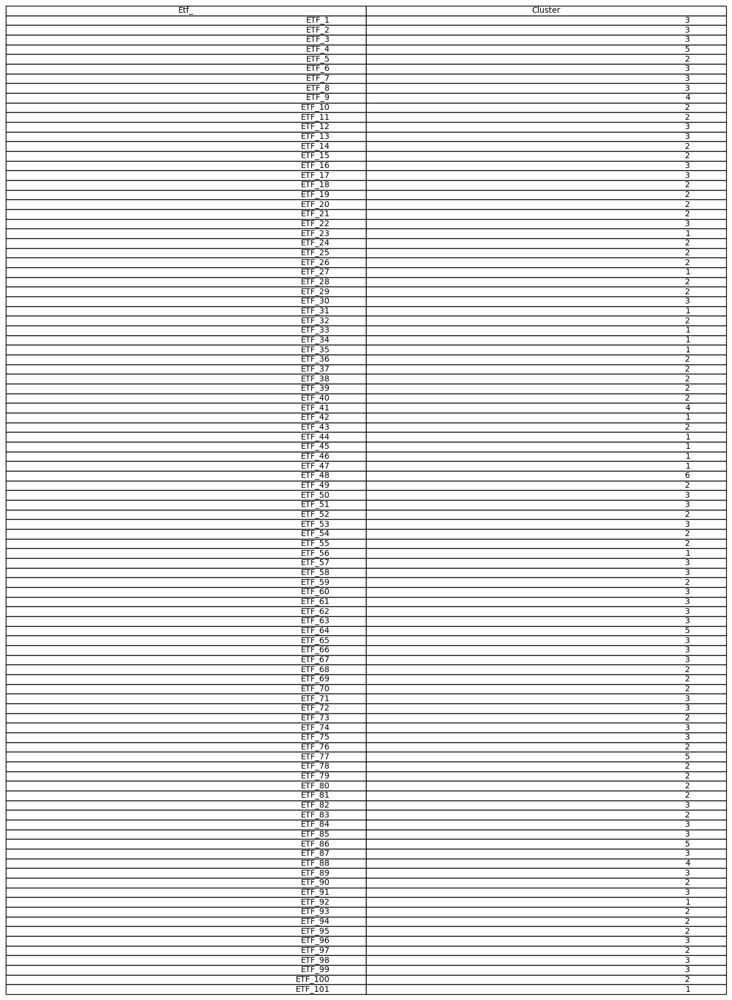

In [53]:
dict={'Etf_':list(df_VaR.drop(columns=['PC-1','PC-2']).T.columns),
      'Cluster':list(labels)}

df_clus=pd.DataFrame(dict)
df_clus

# Tracer le DataFrame sous forme de table
ax = plt.subplot(111, frame_on=False)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
table = plt.table(cellText=df_clus.values, colLabels=df_clus.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1)

# Enregistrer l'image en PNG
plt.savefig('TabClusterCAH_vol.png', bbox_inches='tight', pad_inches=0)

In [54]:
df_clus['Cluster'].value_counts()

2    42
3    37
1    14
5     4
4     3
6     1
Name: Cluster, dtype: int64

We can use both ClusterInfo and High_Corr to identify the etf in both sample of varriable

In [55]:
# Etf in cluster 5
for i in range(1,7):
    display(ClusterInfo(df_clus,i))

,Etf_,Cluster
22,ETF_23,1
26,ETF_27,1
30,ETF_31,1
32,ETF_33,1
33,ETF_34,1
34,ETF_35,1
41,ETF_42,1
43,ETF_44,1
44,ETF_45,1
45,ETF_46,1


,Etf_,Cluster
4,ETF_5,2
9,ETF_10,2
10,ETF_11,2
13,ETF_14,2
14,ETF_15,2
17,ETF_18,2
18,ETF_19,2
19,ETF_20,2
20,ETF_21,2
23,ETF_24,2


,Etf_,Cluster
0,ETF_1,3
1,ETF_2,3
2,ETF_3,3
5,ETF_6,3
6,ETF_7,3
7,ETF_8,3
11,ETF_12,3
12,ETF_13,3
15,ETF_16,3
16,ETF_17,3


,Etf_,Cluster
8,ETF_9,4
40,ETF_41,4
87,ETF_88,4


,Etf_,Cluster
3,ETF_4,5
63,ETF_64,5
76,ETF_77,5
85,ETF_86,5


,Etf_,Cluster
47,ETF_48,6


#### Comments

## Relationships between ETFs and main assets classes

In [56]:
#Correlation 
cor=ret.corr()

This is the correlation between some ETFs and benchmark 

Wall time: 1.3 s


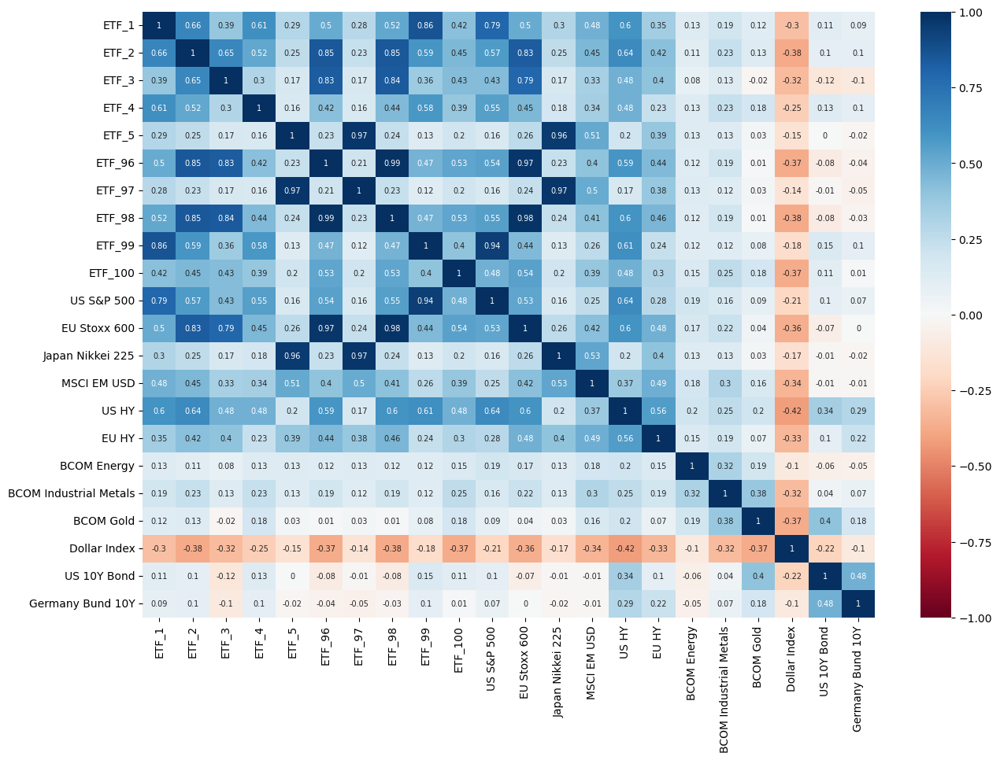

In [57]:
%%time
#correletion heatmap for 10 ETF
plt.figure(figsize=(15,10))
correlations = ret[etf_graph].corr()
sns.heatmap(round(correlations,2), cmap='RdBu', annot=True, 
            annot_kws={"size": 7}, vmin=-1, vmax=1);
plt.savefig('cormat1.png', format='png')

This is the correlation between all ETFs and benchmark 

Wall time: 8.12 s


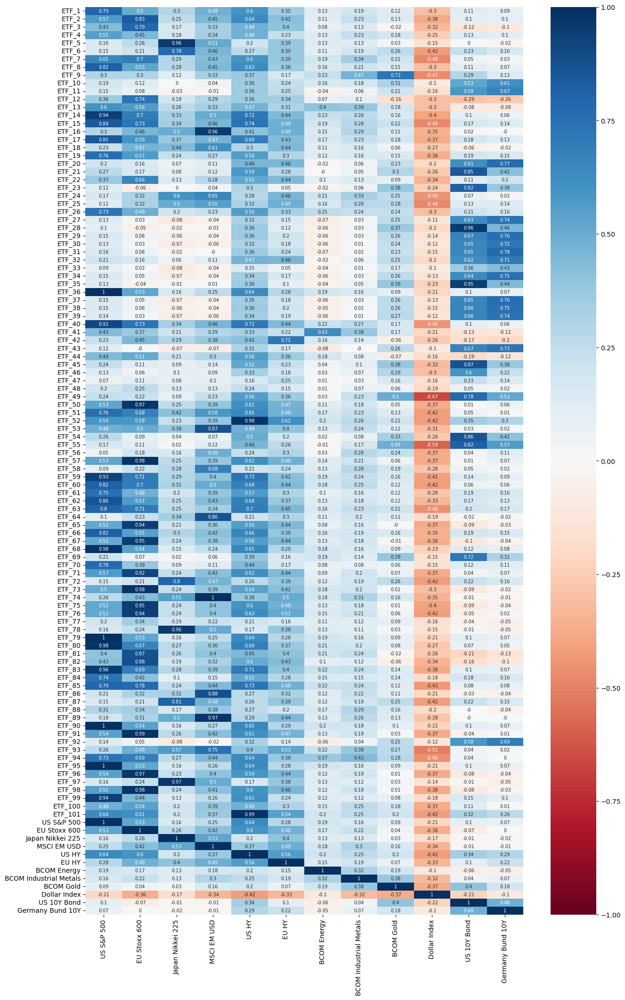

In [58]:
%%time
#correletion heatmap for ETF and Bens

plt.figure(figsize=(15,25))
correlations_tot = ret.corr()
sns.heatmap(round(correlations_tot[Ben],2), cmap='RdBu', annot=True, 
            annot_kws={"size": 7}, vmin=-1, vmax=1);
plt.savefig('cormat2.png', format='png')

* Now we can identify which ETFs are highly correlated to our benchmark.
* A similarity is considered to exist when the correlation is greater than or equal to 95%.

In [59]:
# ETFs that look like our benchmark
for i in Ben:
    print(i)
    print(High_Cor(df,i,correlations_tot))
    print('---------------------------------------------------------------------------------------')

US S&P 500
['ETF_36', 'ETF_68', 'ETF_79', 'ETF_80', 'ETF_83', 'ETF_90', 'ETF_95', 'US S&P 500']
---------------------------------------------------------------------------------------
EU Stoxx 600
['ETF_50', 'ETF_57', 'ETF_67', 'ETF_73', 'ETF_75', 'ETF_91', 'ETF_96', 'ETF_98', 'EU Stoxx 600']
---------------------------------------------------------------------------------------
Japan Nikkei 225
['ETF_5', 'ETF_78', 'ETF_97', 'Japan Nikkei 225']
---------------------------------------------------------------------------------------
MSCI EM USD
['ETF_16', 'ETF_74', 'ETF_89', 'MSCI EM USD']
---------------------------------------------------------------------------------------
US HY
['ETF_52', 'ETF_101', 'US HY']
---------------------------------------------------------------------------------------
EU HY
['EU HY']
---------------------------------------------------------------------------------------
BCOM Energy
['BCOM Energy']
------------------------------------------------------------

In [60]:
%%time
# High correlation plots

for i in list(df2.columns):
    hc=High_Cor(df,i,correlations_tot)
    fig = px.line(df[hc]/df[hc].iloc[0,:], template='plotly_white')
    fig.show()

Wall time: 1.08 s


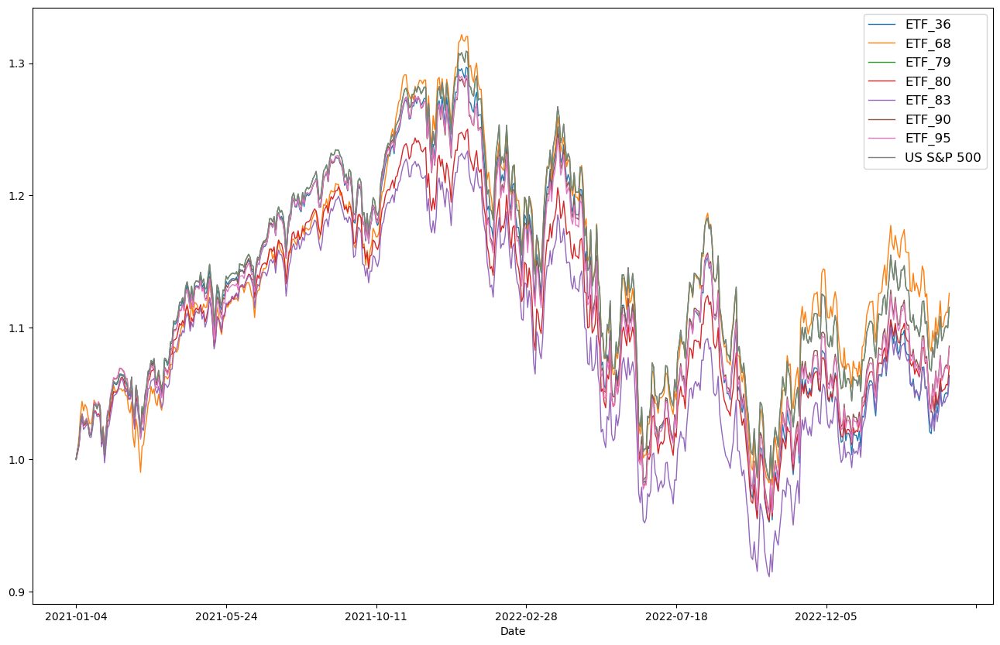

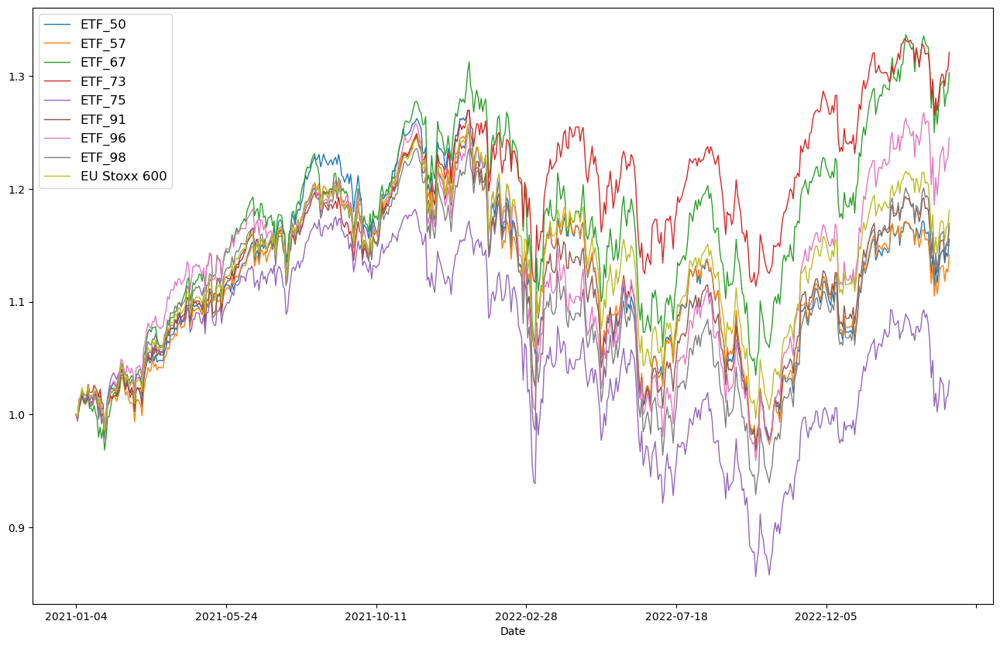

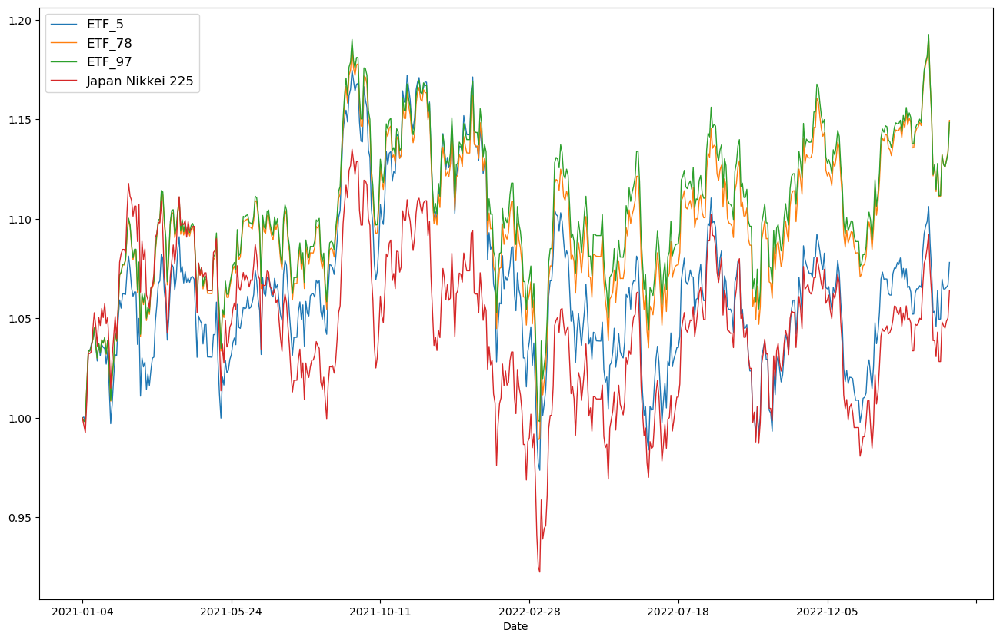

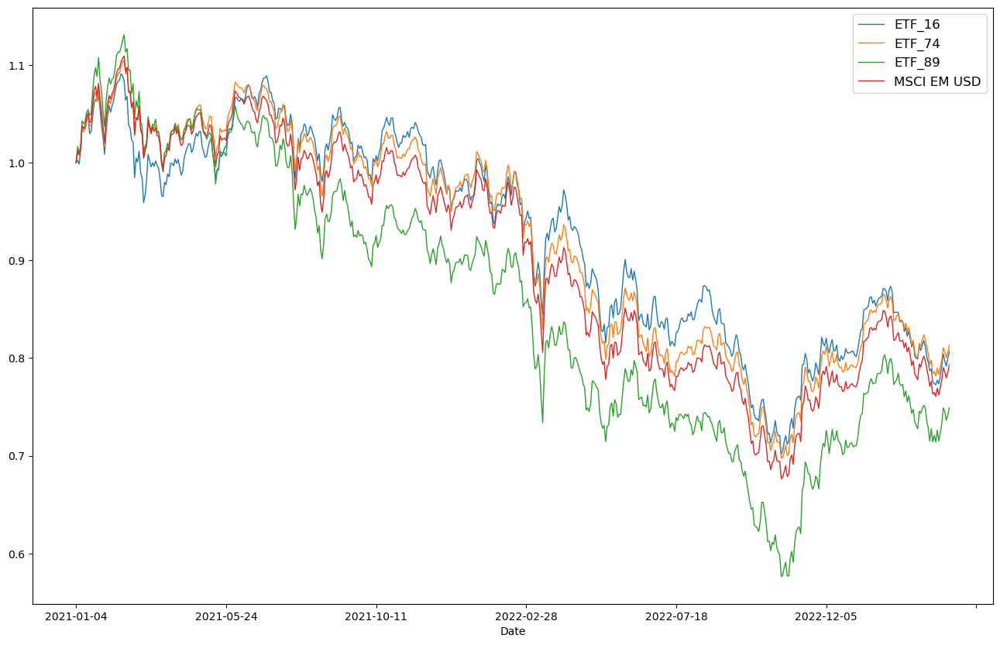

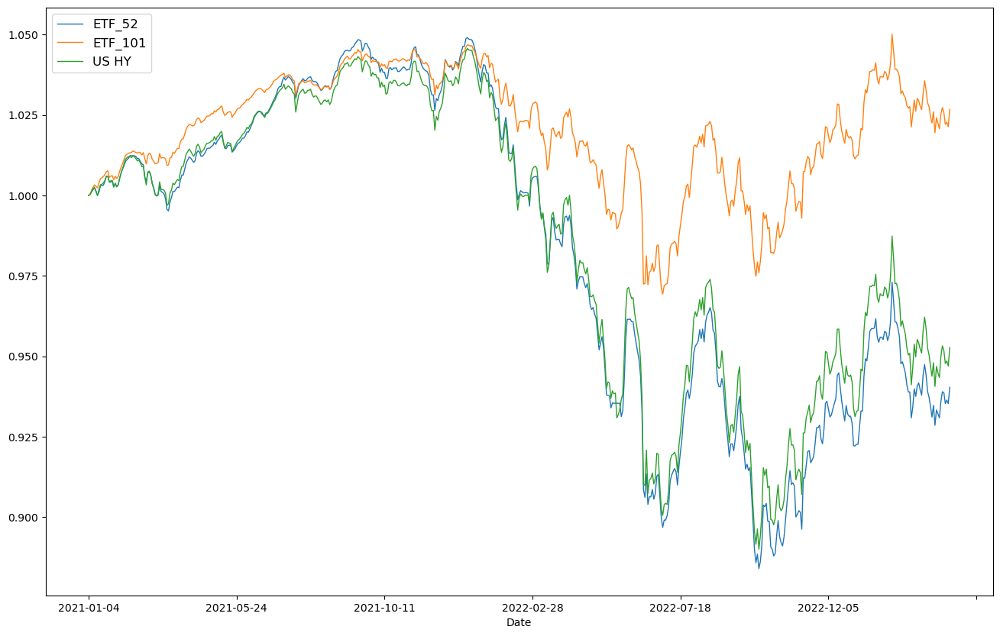

...

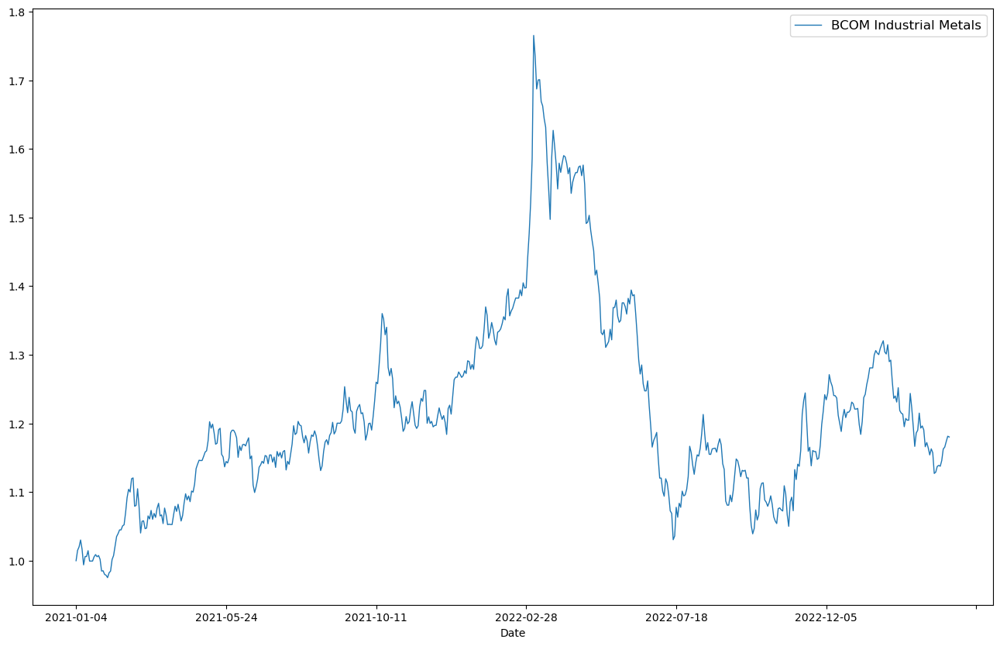

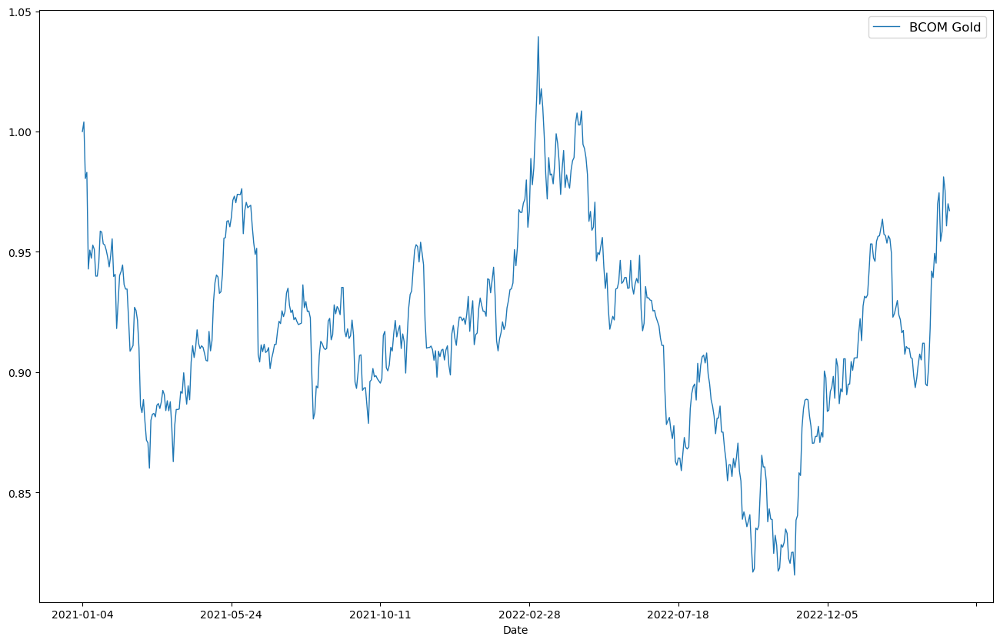

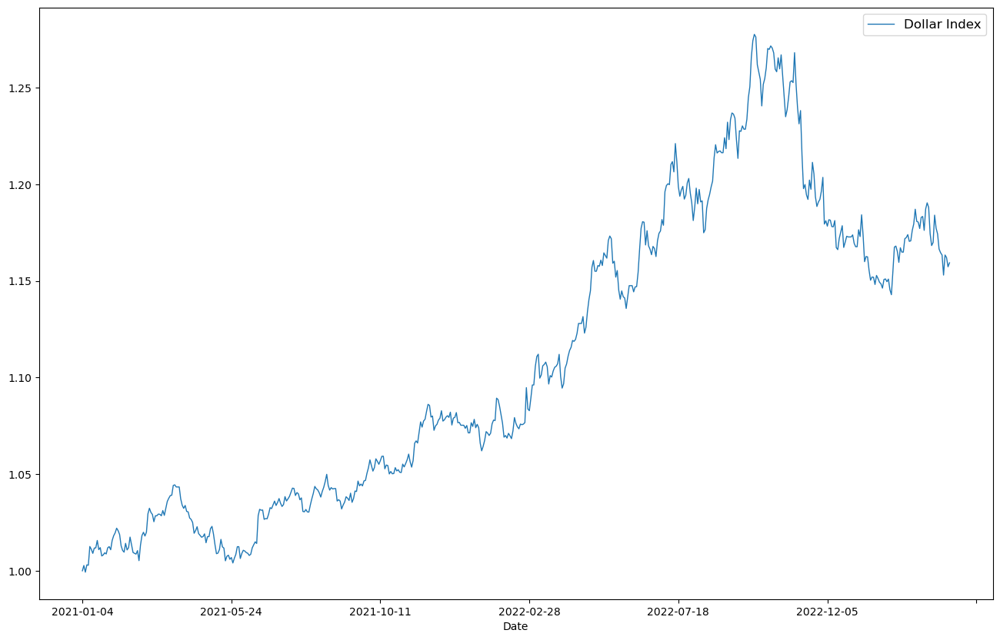

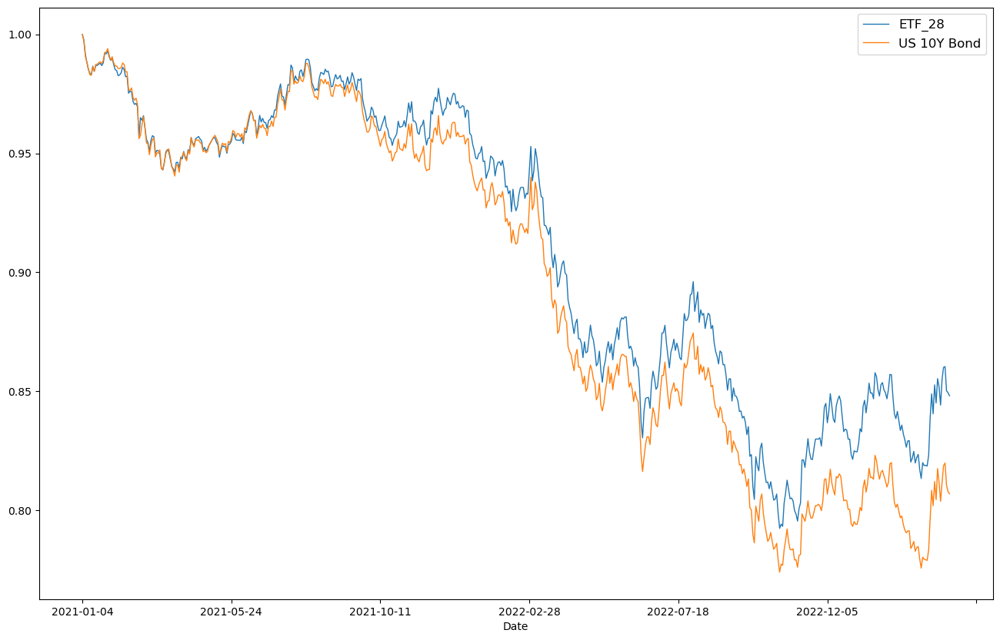

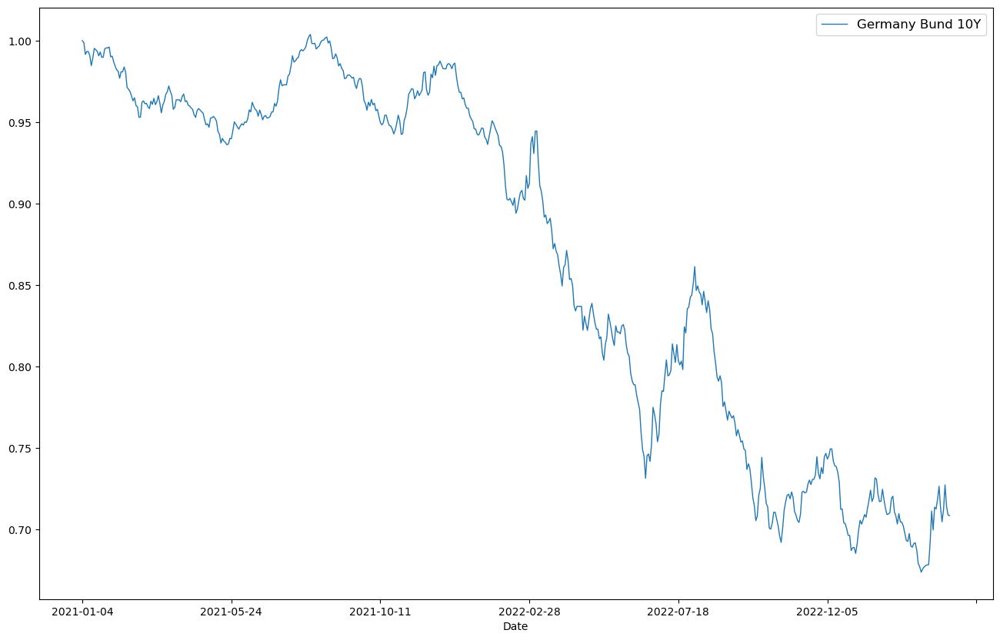

In [61]:
# High correlation 

for i,j in zip(list(df2.columns),range(12)):
    hc=High_Cor(df,i,correlations_tot)
    ax1 = (df[hc]/df[hc].iloc[0,:]).plot()
    plt.savefig('group'+str(j)+'.png', format='png')

Correlation only can't allow us to identify whith eft are close to Bens, we're going to analyse cointegration and cluster 

### Hierarchical Clustering

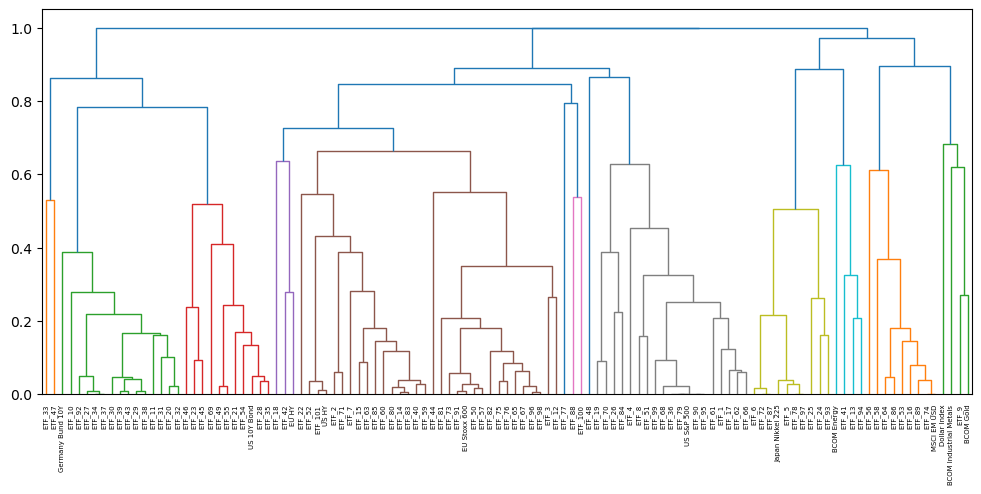

In [62]:
plt.figure(figsize=(12,5))
dissimilarity = 1 - abs(correlations_tot)
'''
Dissimilarity is a measure of the difference or distance between two objects or items in a data set. 
  It is often used to compare items in areas such as classification, clustering analysis, association search, 
  etc.
'''
Z = linkage(squareform(dissimilarity), 'complete')

'''
- squareform(dissimilarity) converts the dissimilarity matrix into a distance matrix in 
                             two-dimensional array.
- method='complete' indicates that the complete linking method is used to group the points.
                  This method calculates the maximum distance between the points of two groups to determine 
                  the distance between the groups.
                  
'''

dendrogram(Z, labels=correlations_tot.columns, orientation='top', 
           leaf_rotation=90);
plt.savefig('dendogram.png', format='png')

In [63]:
# Clusterize the data
threshold = 0.8
labels = fcluster(Z, threshold, criterion='distance')

# Show the cluster
labels

array([ 5,  3,  3,  5,  7,  7,  3,  5, 10,  2,  2,  3,  8,  3,  3,  9,  5,
        3,  5,  2,  2,  3,  2,  7,  7,  5,  2,  2,  2,  2,  2,  2,  1,  2,
        2,  5,  2,  2,  2,  3,  8,  3,  2,  3,  2,  2,  1,  6,  2,  3,  5,
        3,  9,  2,  2,  9,  3,  9,  3,  3,  5,  5,  3,  9,  3,  5,  3,  5,
        2,  5,  3,  7,  3,  9,  3,  3,  4,  7,  5,  3,  3,  3,  3,  5,  3,
        9,  7,  4,  9,  5,  3,  2,  7,  8,  5,  3,  7,  3,  5,  4,  3,  5,
        3,  7,  9,  3,  3,  8, 10, 10, 10,  2,  2], dtype=int32)

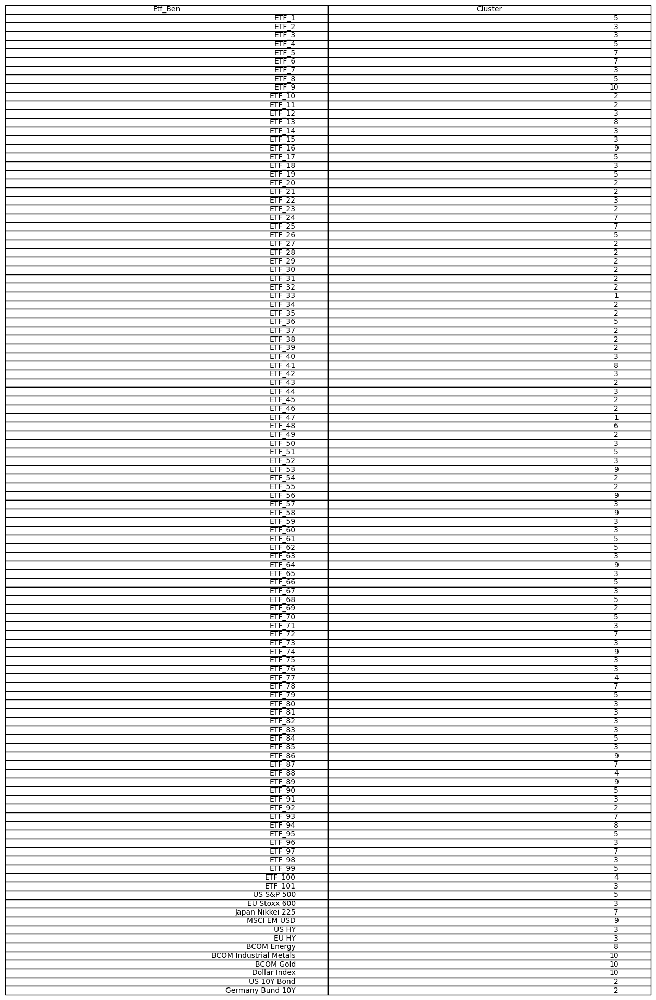

In [64]:
dict={'Etf_Ben':list(correlations_tot.columns),
      'Cluster':list(labels)}

df_clus=pd.DataFrame(dict)
df_clus

# Tracer le DataFrame sous forme de table
ax = plt.subplot(111, frame_on=False)
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
table = plt.table(cellText=df_clus.values, colLabels=df_clus.columns, loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1)

# Enregistrer l'image en PNG
plt.savefig('TabClusterCAH.png', bbox_inches='tight', pad_inches=0)

In [65]:
# Number of ETFs in each cluster 
df_clus['Cluster'].value_counts()

3     35
2     26
5     19
7     10
9      9
10     4
8      4
4      3
1      2
6      1
Name: Cluster, dtype: int64

label shows which cluster each of the features belongs to. Finally, to observe the clusters in the correlation plot, we have to rearrange the features in the dataframe according to the cluster output.

In [66]:
# Keep the indices to sort labels
labels_order = np.argsort(labels)

# Build a new dataframe with the sorted columns
for idx, i in enumerate(df.columns[labels_order]):
    if idx == 0:
        clustered = pd.DataFrame(df[i])
    else:
        df_to_append = pd.DataFrame(df[i])
        clustered = pd.concat([clustered, df_to_append], axis=1)

Finally, we plot the clustered correlation plot:

Wall time: 25.2 s


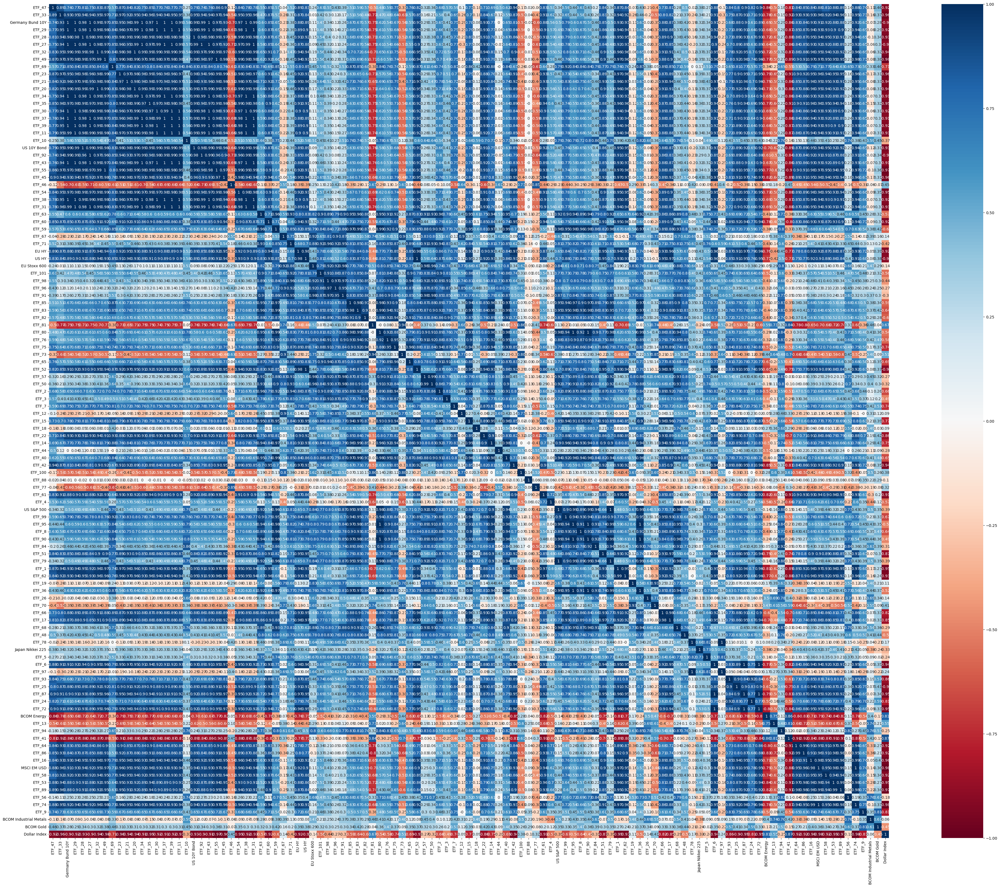

In [67]:
%%time
plt.figure(figsize=(50,40))
correlations = clustered.corr()
sns.heatmap(round(correlations,2), cmap='RdBu', annot=True, 
            annot_kws={"size": 10}, vmin=-1, vmax=1);
plt.savefig('clustered_correlation.png', format='png')

We can use both ClusterInfo and High_Corr to identify the etf in both sample of varriable

In [68]:

for i in range(1,11):
    display(ClusterInfo(df_clus,i))

,Etf_Ben,Cluster
32,ETF_33,1
46,ETF_47,1


,Etf_Ben,Cluster
9,ETF_10,2
10,ETF_11,2
19,ETF_20,2
20,ETF_21,2
22,ETF_23,2
26,ETF_27,2
27,ETF_28,2
28,ETF_29,2
29,ETF_30,2
30,ETF_31,2


,Etf_Ben,Cluster
1,ETF_2,3
2,ETF_3,3
6,ETF_7,3
11,ETF_12,3
13,ETF_14,3
14,ETF_15,3
17,ETF_18,3
21,ETF_22,3
39,ETF_40,3
41,ETF_42,3


,Etf_Ben,Cluster
76,ETF_77,4
87,ETF_88,4
99,ETF_100,4


,Etf_Ben,Cluster
0,ETF_1,5
3,ETF_4,5
7,ETF_8,5
16,ETF_17,5
18,ETF_19,5
25,ETF_26,5
35,ETF_36,5
50,ETF_51,5
60,ETF_61,5
61,ETF_62,5


,Etf_Ben,Cluster
47,ETF_48,6


,Etf_Ben,Cluster
4,ETF_5,7
5,ETF_6,7
23,ETF_24,7
24,ETF_25,7
71,ETF_72,7
77,ETF_78,7
86,ETF_87,7
92,ETF_93,7
96,ETF_97,7
103,Japan Nikkei 225,7


,Etf_Ben,Cluster
12,ETF_13,8
40,ETF_41,8
93,ETF_94,8
107,BCOM Energy,8


,Etf_Ben,Cluster
15,ETF_16,9
52,ETF_53,9
55,ETF_56,9
57,ETF_58,9
63,ETF_64,9
73,ETF_74,9
85,ETF_86,9
88,ETF_89,9
104,MSCI EM USD,9


,Etf_Ben,Cluster
8,ETF_9,10
108,BCOM Industrial Metals,10
109,BCOM Gold,10
110,Dollar Index,10


In [69]:
High_Cor(df,'US S&P 500',correlations_tot)

['ETF_36',
 'ETF_68',
 'ETF_79',
 'ETF_80',
 'ETF_83',
 'ETF_90',
 'ETF_95',
 'US S&P 500']

As we can see the common element of this two set are:

* US S&P500=>{ETF36,ETF68,ETF79,ETF90,ETF95}
* EU Sock 600=>{ETF50,ETF57,ETF67,ETF73,ETF91,ETF96,ETF98}
* Nikkei 225=>{ETF5,ETF78,ETF97}
* MSCI =>{ETF16,ETF74,ETF89}
* US HY=>{ETF52,ETF101}
* US 10Y Bond=>{ETF28}

### Kmeans

In [70]:
ret

,ETF_1,ETF_2,ETF_3,ETF_4,ETF_5,ETF_6,ETF_7,ETF_8,ETF_9,ETF_10,...,Japan Nikkei 225,MSCI EM USD,US HY,EU HY,BCOM Energy,BCOM Industrial Metals,BCOM Gold,Dollar Index,US 10Y Bond,Germany Bund 10Y
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-05,0.006644,0.000839,-0.007476,0.020321,0.000410,0.002695,-0.002205,0.017210,-0.003666,0.000252,...,-0.003660,0.011922,0.000193,0.000296,0.044974,0.015076,0.004007,0.002738,-0.002813,-0.001300
2021-01-06,-0.021007,-0.005644,-0.008946,0.053786,-0.003423,-0.004339,0.017570,-0.001568,-0.000085,0.000963,...,-0.003781,-0.003519,0.001051,0.000607,0.009504,0.005005,-0.023434,-0.003444,-0.006406,-0.007150
2021-01-07,0.012036,-0.008389,0.013753,0.069150,0.015391,0.011871,0.021470,0.029686,-0.004040,0.001169,...,0.016048,0.005334,0.000776,0.000851,0.003104,0.009851,0.002620,0.003782,-0.002500,0.001825
2021-01-08,0.020835,0.026744,-0.004536,0.010413,0.020738,0.020800,0.003015,0.009075,-0.034430,0.002344,...,0.023605,0.023635,0.000520,0.000869,0.013078,-0.013174,-0.040866,-0.000186,-0.002969,-0.000075
2021-01-11,-0.005786,-0.006955,-0.011561,-0.037496,0.000100,-0.004797,-0.013355,0.005214,-0.027116,-0.002339,...,0.000000,-0.002905,-0.001332,0.000239,0.004023,-0.022291,0.008365,0.009673,-0.002344,-0.002650
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-23,0.024771,0.021792,-0.004029,0.010516,-0.004631,0.007812,-0.000658,0.025367,0.024058,0.010507,...,-0.001699,0.016937,-0.001448,0.000662,-0.009353,0.014685,0.023747,-0.008925,0.008906,0.010900
2023-03-24,0.004462,-0.022785,-0.019403,-0.010194,-0.000053,0.001387,-0.003922,-0.014530,0.007302,0.000854,...,-0.001253,-0.005458,-0.004300,-0.001710,-0.001315,0.002336,-0.005762,0.009006,0.001250,0.021050
2023-03-27,-0.003329,0.002461,0.018850,0.002388,0.000860,-0.005089,0.000116,-0.008668,-0.000457,-0.004410,...,0.003349,-0.008212,0.000819,0.001154,0.019048,0.007030,-0.015087,-0.001103,-0.011250,-0.018000


In [71]:
km = KMeans(n_clusters=10, max_iter=1000,random_state=1)
cluster_ids = km.fit_predict(ret.T)

In [72]:
cluster_ids

array([3, 6, 6, 3, 8, 8, 3, 3, 1, 0, 0, 6, 1, 3, 3, 5, 3, 5, 3, 0, 0, 6,
       0, 8, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 0, 0, 3, 1, 0, 0, 0,
       0, 0, 0, 7, 0, 6, 3, 0, 5, 0, 0, 0, 6, 5, 3, 3, 3, 3, 3, 2, 6, 3,
       6, 3, 0, 3, 6, 8, 6, 5, 6, 6, 4, 8, 3, 3, 6, 6, 3, 3, 3, 2, 8, 1,
       5, 3, 6, 0, 5, 1, 3, 6, 8, 6, 3, 3, 0, 3, 6, 8, 5, 0, 0, 9, 1, 0,
       0, 0, 0])

In [73]:
df_kmeans = pd.DataFrame()
df_kmeans["Etf_Ben"] = list(ret.columns)
df_kmeans["cluster_id"] = cluster_ids
df_kmeans = df_kmeans.sort_values(by="cluster_id").reset_index(drop=True)
display(df_kmeans)

,Etf_Ben,cluster_id
0,Germany Bund 10Y,0
1,ETF_29,0
2,ETF_30,0
3,ETF_32,0
4,ETF_33,0
...,...,...
108,ETF_78,8
109,ETF_87,8
110,ETF_72,8
111,Japan Nikkei 225,8


### PCA

In this part we evaluate the  PCA in order to verify our cluster 

In [74]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

In [75]:
PCA=pca.fit(ret.T)

In [76]:
display(PCA.explained_variance_ratio_,
        PCA.singular_values_)

array([0.21029185, 0.13199362])

array([1.16707063, 0.92461811])

In [77]:
mvts_2D=PCA.fit_transform(ret.T)

In [78]:
r=ret.T

In [79]:
r["PC-1"] = mvts_2D[:, 0]
r["PC-2"] = mvts_2D[:, 1]

fig = px.scatter(r, x="PC-1", y="PC-2", text=r.index,
                 color_discrete_sequence=["green"], size_max=10,template='plotly_white')
fig.update_traces(textposition='top center', textfont_size=10)
fig.update_layout(title="PCA Projection of Assets",
                  xaxis_title="PC-1", yaxis_title="PC-2",
                  width=1000, height=800)
fig.show()

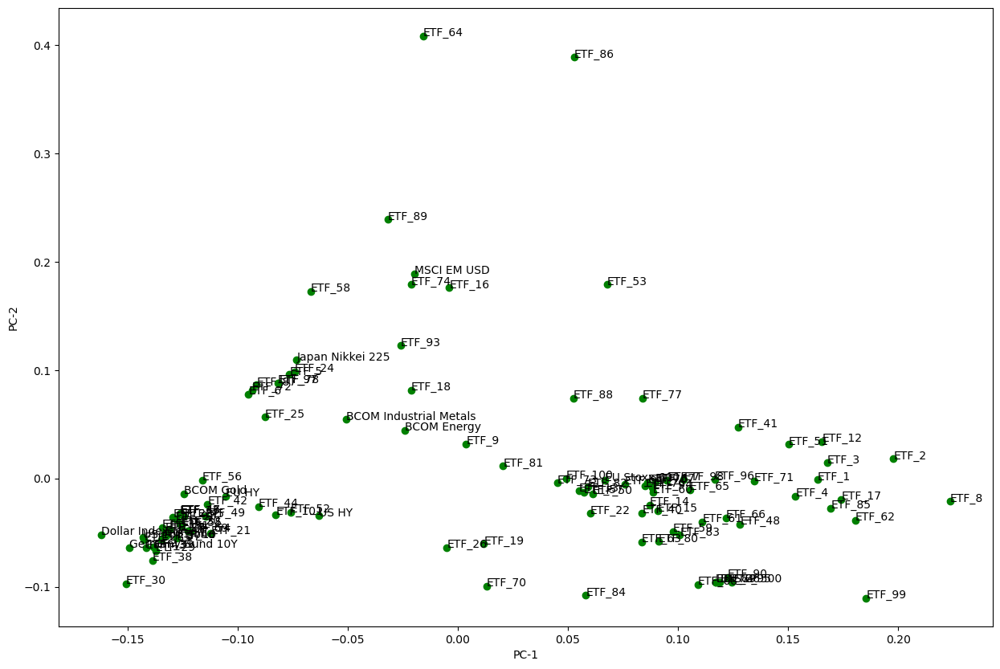

<Figure size 1600x1000 with 0 Axes>

In [80]:
fig = plt.figure(figsize=(15, 10))  # figsize=(20, 20)

for n in range(len(ret.columns)):
    x = mvts_2D[n, 0]
    y = mvts_2D[n, 1]
    asset = ret.columns[n]
    plt.scatter(x, y, c="g")
    plt.text(x, y, asset, fontsize=10,)  # alpha=0.5)
plt.xlabel("PC-1")
plt.ylabel("PC-2")
plt.show()
plt.savefig('FigPCA.png', format='png')

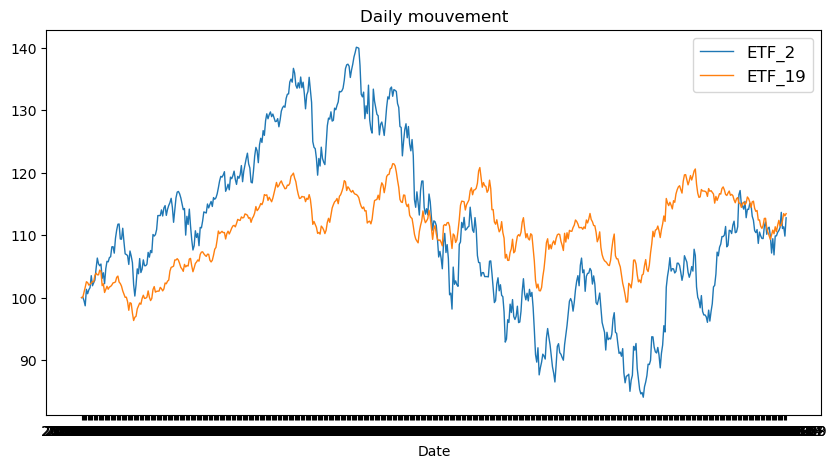

In [81]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
for symbol in ["ETF_2", "ETF_19"]:
    ax.plot(df[symbol], label=symbol)
ax.set_title('Daily mouvement')
ax.set_xlabel('Date')
ax.legend() 
plt.savefig('GraphPCA.png', format='png')

### Risk Profil

risk profiles:

* Conservative Risk Profile: Investors with a conservative risk profile prefer investments with low volatility and minimal risk. ETFs that fit this risk profile may include government bonds, low-risk corporate bonds, large-cap stocks, or investment-grade bond ETFs.

* Moderate Risk Profile: Investors with a moderate risk profile may be willing to take on a little more risk to achieve a higher return. ETFs that fit this risk profile may include low volatility equity ETFs, dividend equity ETFs, high yield bond ETFs, or sector equity ETFs.

* Aggressive Risk Profile: Investors with an aggressive risk profile are willing to take on higher risks to achieve higher returns over the long term. ETFs that fit this risk profile may include emerging equity ETFs, technology equity ETFs, small cap equity ETFs, or commodity ETFs.

We calculate the annual volatility of the ETFs using the sample standard deviation method and multiplying by the square root of the number of annual trading days (252 days). We then rank the risk profiles according to their level of volatility, using the 0.1 and 0.2 thresholds as cut-off points.

Finally, we display the ETFs corresponding to each risk profile. ETFs with annual volatility below 0.1 are classified in the conservative risk profile, those with annual volatility between 0.1 and 0.2 are classified in the moderate risk profile, and those with annual volatility above 0.2 are classified in the aggressive risk profile.

In [82]:
returns = ret.drop(columns=Ben)
# annual volotility for ETFs
volatility = np.sqrt(252) * returns.std()

# Risks profiles
risk_profile = {
    "conservateur": [],
    "modéré": [],
    "agressif": []
}

for etf in volatility.index:
    if volatility[etf] < 0.1:
        risk_profile["conservateur"].append(etf)
    elif volatility[etf] < 0.2:
        risk_profile["modéré"].append(etf)
    else:
        risk_profile["agressif"].append(etf)

# Afficher les profils de risque correspondants
print("ETFs for a conservative risk profile:", risk_profile["conservateur"])
print("ETFs for a moderate risk profile:", risk_profile["modéré"])
print("ETFs for an aggressive risk profile:", risk_profile["agressif"])


ETFs for a conservative risk profile: ['ETF_10', 'ETF_11', 'ETF_20', 'ETF_21', 'ETF_23', 'ETF_27', 'ETF_28', 'ETF_29', 'ETF_31', 'ETF_32', 'ETF_33', 'ETF_34', 'ETF_35', 'ETF_37', 'ETF_39', 'ETF_42', 'ETF_43', 'ETF_44', 'ETF_45', 'ETF_46', 'ETF_47', 'ETF_49', 'ETF_52', 'ETF_54', 'ETF_55', 'ETF_56', 'ETF_69', 'ETF_92', 'ETF_101']
ETFs for a moderate risk profile: ['ETF_5', 'ETF_6', 'ETF_7', 'ETF_13', 'ETF_14', 'ETF_15', 'ETF_16', 'ETF_18', 'ETF_19', 'ETF_24', 'ETF_25', 'ETF_26', 'ETF_30', 'ETF_36', 'ETF_38', 'ETF_40', 'ETF_50', 'ETF_57', 'ETF_59', 'ETF_60', 'ETF_63', 'ETF_65', 'ETF_67', 'ETF_68', 'ETF_70', 'ETF_72', 'ETF_73', 'ETF_74', 'ETF_75', 'ETF_76', 'ETF_78', 'ETF_79', 'ETF_80', 'ETF_81', 'ETF_82', 'ETF_83', 'ETF_87', 'ETF_90', 'ETF_91', 'ETF_93', 'ETF_94', 'ETF_95', 'ETF_96', 'ETF_97', 'ETF_98']
ETFs for an aggressive risk profile: ['ETF_1', 'ETF_2', 'ETF_3', 'ETF_4', 'ETF_8', 'ETF_9', 'ETF_12', 'ETF_17', 'ETF_22', 'ETF_41', 'ETF_48', 'ETF_51', 'ETF_53', 'ETF_58', 'ETF_61', 'ETF_6

In [83]:
risk_profile

{'conservateur': ['ETF_10',
  'ETF_11',
  'ETF_20',
  'ETF_21',
  'ETF_23',
  'ETF_27',
  'ETF_28',
  'ETF_29',
  'ETF_31',
  'ETF_32',
  'ETF_33',
  'ETF_34',
  'ETF_35',
  'ETF_37',
  'ETF_39',
  'ETF_42',
  'ETF_43',
  'ETF_44',
  'ETF_45',
  'ETF_46',
  'ETF_47',
  'ETF_49',
  'ETF_52',
  'ETF_54',
  'ETF_55',
  'ETF_56',
  'ETF_69',
  'ETF_92',
  'ETF_101'],
 'modéré': ['ETF_5',
  'ETF_6',
  'ETF_7',
  'ETF_13',
  'ETF_14',
  'ETF_15',
  'ETF_16',
  'ETF_18',
  'ETF_19',
  'ETF_24',
  'ETF_25',
  'ETF_26',
  'ETF_30',
  'ETF_36',
  'ETF_38',
  'ETF_40',
  'ETF_50',
  'ETF_57',
  'ETF_59',
  'ETF_60',
  'ETF_63',
  'ETF_65',
  'ETF_67',
  'ETF_68',
  'ETF_70',
  'ETF_72',
  'ETF_73',
  'ETF_74',
  'ETF_75',
  'ETF_76',
  'ETF_78',
  'ETF_79',
  'ETF_80',
  'ETF_81',
  'ETF_82',
  'ETF_83',
  'ETF_87',
  'ETF_90',
  'ETF_91',
  'ETF_93',
  'ETF_94',
  'ETF_95',
  'ETF_96',
  'ETF_97',
  'ETF_98'],
 'agressif': ['ETF_1',
  'ETF_2',
  'ETF_3',
  'ETF_4',
  'ETF_8',
  'ETF_9',
  'ETF_1

# Allocation 

## Regression 

In [84]:
# create the dataframe with df1 and df3
df_ = pd.merge(df1, df3, on='Date', how='inner').pct_change().dropna()

# Split the data into training and testing sets
X = df_.iloc[:, 0:101]  # Returns of the representative etf
y = df_.iloc[:, 101]  # Returns of the target index 

In [85]:
# split into train and test set 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Perform OLS regression

In [86]:
# Perform OLS multiple linear regression
ols = LinearRegression()
ols.fit(X_train, y_train)

# Test the model
y_pred = ols.predict(X_test)

# Calculate performance metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.1f}')
print(f'R-squared: {r2:.1f}')
# Display the coefficients
for ticker, coef in zip(list(X.columns), ols.coef_*100):
    print(f'{ticker}: {coef:.2f}')

# Allocation
w_ols = pd.DataFrame({'ETF':list(X.columns),'w_ols':list(ols.coef_*100)}).round(4)

Mean Squared Error: 0.0
R-squared: 1.0
ETF_1: -0.00
ETF_2: -0.00
ETF_3: -0.00
ETF_4: -0.00
ETF_5: -0.00
ETF_6: 0.00
ETF_7: 0.00
ETF_8: 10.00
ETF_9: 0.00
ETF_10: -0.00
ETF_11: 0.00
ETF_12: 0.00
ETF_13: -0.00
ETF_14: -0.00
ETF_15: 0.00
ETF_16: 0.00
ETF_17: 0.00
ETF_18: 0.00
ETF_19: 0.00
ETF_20: 0.00
ETF_21: -0.00
ETF_22: -0.00
ETF_23: -0.00
ETF_24: 0.00
ETF_25: -0.00
ETF_26: 5.00
ETF_27: -0.00
ETF_28: -0.00
ETF_29: -0.00
ETF_30: 0.00
ETF_31: 10.00
ETF_32: -0.00
ETF_33: 0.00
ETF_34: -0.00
ETF_35: 0.00
ETF_36: 5.00
ETF_37: 0.00
ETF_38: -0.00
ETF_39: -0.00
ETF_40: 5.00
ETF_41: 0.00
ETF_42: 0.00
ETF_43: 20.00
ETF_44: -0.00
ETF_45: -0.00
ETF_46: 0.00
ETF_47: 0.00
ETF_48: 0.00
ETF_49: 0.00
ETF_50: -0.00
ETF_51: -0.00
ETF_52: -0.00
ETF_53: -0.00
ETF_54: 10.00
ETF_55: -0.00
ETF_56: -0.00
ETF_57: 0.00
ETF_58: 0.00
ETF_59: 0.00
ETF_60: 0.00
ETF_61: -0.00
ETF_62: -0.00
ETF_63: 0.00
ETF_64: 10.00
ETF_65: 0.00
ETF_66: 0.00
ETF_67: 0.00
ETF_68: -0.00
ETF_69: -0.00
ETF_70: 0.00
ETF_71: 0.00
ETF_72: -0.

In [87]:
w_ols

,ETF,w_ols
0,ETF_1,-0.0
1,ETF_2,-0.0
2,ETF_3,-0.0
3,ETF_4,-0.0
4,ETF_5,-0.0
...,...,...
96,ETF_97,-0.0
97,ETF_98,-0.0
98,ETF_99,0.0
99,ETF_100,5.0


### Perform Lasso regression

We perform Lasso regression in order to solve the overfiting 

In [88]:
# Research best alpha for Lasso 
# List of alpha values to try
alphas = [0.0001,0.001, 0.01, 0.1, 1.0, 10.0, 100.0]

# Perform Lasso regression with cross-validation
lasso_cv = LassoCV(alphas=alphas,normalize=True, cv=5)
lasso_cv.fit(X, y)

# Get the best alpha value
best_alpha = lasso_cv.alpha_
print(f'Best alpha: {best_alpha}')


Best alpha: 0.0001


In [89]:
alpha = 0.0001
lasso = Lasso(alpha=alpha, normalize=True)
lasso.fit(X_train, y_train)

# Test the model
y_pred = lasso.predict(X_test)

# Calculate performance metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.6f}')
print(f'R-squared: {r2:.6f}')

# Display the coefficients
for ticker, coef in zip(list(X.columns), lasso.coef_*100):
    print(f'{ticker}: {coef:.2f}')
    
w_lasso = pd.DataFrame({'ETF':list(X.columns),'w_lasso':list(lasso.coef_*100)}).round(4)

Mean Squared Error: 0.000008
R-squared: 0.792707
ETF_1: 0.00
ETF_2: 0.00
ETF_3: 0.00
ETF_4: 0.00
ETF_5: 0.00
ETF_6: 0.00
ETF_7: 0.00
ETF_8: 0.96
ETF_9: 0.00
ETF_10: 0.00
ETF_11: 0.00
ETF_12: 0.00
ETF_13: 0.00
ETF_14: 33.93
ETF_15: 1.70
ETF_16: 0.00
ETF_17: 0.00
ETF_18: 0.00
ETF_19: 0.00
ETF_20: 0.00
ETF_21: 0.00
ETF_22: 0.00
ETF_23: 0.00
ETF_24: 0.00
ETF_25: 0.00
ETF_26: 0.00
ETF_27: 0.00
ETF_28: 0.00
ETF_29: 0.00
ETF_30: 0.00
ETF_31: 0.00
ETF_32: 0.00
ETF_33: 0.00
ETF_34: 0.00
ETF_35: 0.00
ETF_36: 0.00
ETF_37: 0.00
ETF_38: 0.00
ETF_39: 0.00
ETF_40: 0.00
ETF_41: 0.00
ETF_42: 0.00
ETF_43: 0.00
ETF_44: 0.00
ETF_45: 0.00
ETF_46: 0.00
ETF_47: 0.00
ETF_48: 0.00
ETF_49: 0.00
ETF_50: 0.00
ETF_51: 0.00
ETF_52: 0.00
ETF_53: 3.63
ETF_54: 0.00
ETF_55: 0.00
ETF_56: 0.00
ETF_57: 0.00
ETF_58: 0.00
ETF_59: 0.00
ETF_60: 0.00
ETF_61: 0.00
ETF_62: 0.00
ETF_63: 0.00
ETF_64: 0.00
ETF_65: 0.00
ETF_66: 0.00
ETF_67: 0.00
ETF_68: 0.00
ETF_69: 0.00
ETF_70: 0.00
ETF_71: 0.00
ETF_72: 0.00
ETF_73: 0.00
ETF_74: 0.

### Perform Ridge regression

In [90]:
# research best alpha for Ridge 
# List of alpha values to try
alphas = [0.0001,0.001, 0.01, 0.1, 1.0, 10.0, 100.0]

# Perform Ridge regression with cross-validation
ridge_cv = RidgeCV(alphas=alphas, normalize=True, scoring='neg_mean_squared_error')
ridge_cv.fit(X, y)

# Get the best alpha value
best_alpha = ridge_cv.alpha_
print(f'Best alpha: {best_alpha}')

Best alpha: 0.0001


In [91]:

alpha = 0.0001
ridge = Ridge(alpha=alpha, normalize=True)
ridge.fit(X_train, y_train)

# Test the model
y_pred = ridge.predict(X_test)

# Calculate performance metrics
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f'Mean Squared Error: {mse:.6f}')
print(f'R-squared: {r2:.6f}')

# Display the coefficients
for ticker, coef in zip(list(X.columns), (ridge.coef_*100).round(1)):
    print(f'{ticker}: {coef:.2f}')
    
# Allocation 
w_ridge = pd.DataFrame({'ETF':list(X.columns),'w_ridge':list(ridge.coef_*100)})

Mean Squared Error: 0.000000
R-squared: 0.999999
ETF_1: 0.00
ETF_2: 0.00
ETF_3: 0.00
ETF_4: -0.00
ETF_5: -0.00
ETF_6: -0.00
ETF_7: 0.00
ETF_8: 10.00
ETF_9: 0.00
ETF_10: 0.00
ETF_11: -0.00
ETF_12: 0.00
ETF_13: 0.00
ETF_14: 0.30
ETF_15: 0.00
ETF_16: 0.00
ETF_17: 0.00
ETF_18: 0.00
ETF_19: 0.00
ETF_20: -0.00
ETF_21: 0.00
ETF_22: 0.00
ETF_23: 0.00
ETF_24: 0.00
ETF_25: -0.00
ETF_26: 5.00
ETF_27: -0.10
ETF_28: 0.00
ETF_29: -0.00
ETF_30: 0.10
ETF_31: 10.10
ETF_32: 0.20
ETF_33: -0.40
ETF_34: 0.10
ETF_35: 0.00
ETF_36: 4.70
ETF_37: -0.10
ETF_38: -0.10
ETF_39: 0.40
ETF_40: 5.00
ETF_41: 0.00
ETF_42: -0.20
ETF_43: 19.70
ETF_44: -0.00
ETF_45: -0.10
ETF_46: 0.20
ETF_47: 0.10
ETF_48: -0.00
ETF_49: -0.40
ETF_50: -0.00
ETF_51: -0.00
ETF_52: 0.00
ETF_53: -0.00
ETF_54: 10.00
ETF_55: 0.00
ETF_56: 0.00
ETF_57: -0.00
ETF_58: -0.00
ETF_59: 0.20
ETF_60: -0.00
ETF_61: 0.00
ETF_62: -0.00
ETF_63: 0.00
ETF_64: 10.00
ETF_65: -0.00
ETF_66: -0.00
ETF_67: -0.00
ETF_68: -0.10
ETF_69: 0.00
ETF_70: -0.00
ETF_71: 0.00
ETF_

In [92]:
w_ridge.round(1)

,ETF,w_ridge
0,ETF_1,0.0
1,ETF_2,0.0
2,ETF_3,0.0
3,ETF_4,-0.0
4,ETF_5,-0.0
...,...,...
96,ETF_97,-0.2
97,ETF_98,0.1
98,ETF_99,-0.0
99,ETF_100,5.0


#### Allocation for our regression 

In [93]:
Weight=pd.merge(w_ols,w_ridge, on='ETF', how='inner')

In [94]:
Weight

,ETF,w_ols,w_ridge
0,ETF_1,-0.0,0.001965
1,ETF_2,-0.0,0.002396
2,ETF_3,-0.0,0.005444
3,ETF_4,-0.0,-0.002766
4,ETF_5,-0.0,-0.002403
...,...,...,...
96,ETF_97,-0.0,-0.163107
97,ETF_98,-0.0,0.110525
98,ETF_99,0.0,-0.024533
99,ETF_100,5.0,4.996382


##### Evaluation

In [95]:
dfr=df1/df1.iloc[0]

In [96]:
allo_ols,allo_ridge=(dfr*list(Weight['w_ols'])),(dfr*list(Weight['w_ridge']))

In [97]:
Position_ols,Position_ridge=allo_ols.sum(axis=1),allo_ridge.sum(axis=1)

In [98]:
Position=pd.DataFrame({"MA":df3['Mystery_Allocation'].round(4),
                       "Ols":Position_ols,
                       "Ridge":Position_ridge})

In [99]:
Position

,MA,Ols,Ridge
Date,,,
2021-01-04,100.0000,100.000000,99.749587
2021-01-05,100.4111,100.411115,100.161929
2021-01-06,100.9284,100.928876,100.679368
2021-01-07,101.5077,101.511172,101.261769
2021-01-08,101.9658,101.974224,101.725682
...,...,...,...
2023-03-23,96.6354,95.914936,95.729562
2023-03-24,96.6238,95.866814,95.681102
2023-03-27,96.2586,95.623184,95.438286


In [100]:
fig = px.line(Position, template='plotly_white')
fig.show()

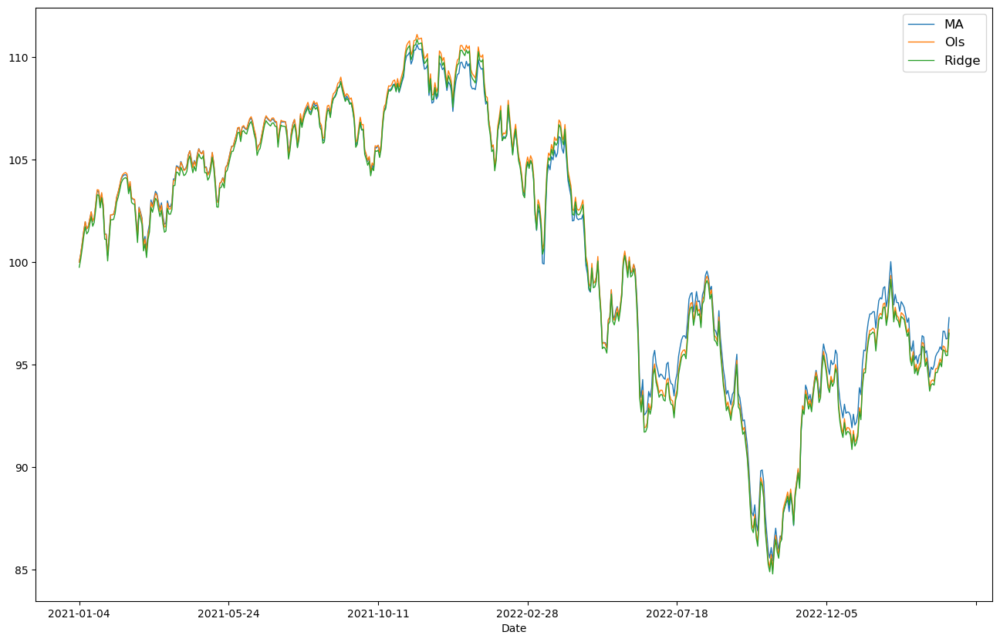

In [101]:
Position.plot()
plt.savefig('Allo.png', format='png')

### Allocation var

Knowing that a time-varying allocation was used to calculate the Mystery_Allocation_v2 strategy, find this allocation. The returns at each date were calculated on the basis of the allocation defined at the previous date. 

## Deep Learning 

In [102]:
# Separate dependent and independent variables
X = df_.iloc[:, 0:101].values   #  101 ETFs
y = df_.iloc[:, 101].values    # Mystery allocation 


# Transform data to be compatible with LSTM layers
X = X.reshape(X.shape[0], X.shape[1], 1)

# Create a neural network model
model = Sequential()

model.add(LSTM(units=100, activation='relu', input_shape=(X.shape[1], X.shape[2])))
model.add(Dense(units=100, activation='relu'))
model.add(Dense(units=100, activation='relu'))
model.add(Dense(units=100, activation='relu'))
model.add(Dense(units=100, activation='relu'))
model.add(Dense(units=101, activation='softmax'))

model.compile(loss='mse', optimizer='adam')

# Train the model on the normalized data
model.fit(X, y, epochs=100, batch_size=32)

# Predicting future returns from current ETF prices
current_prices = X[-1:].reshape(1, -1)
predicted_returns = model.predict(current_prices)

# Impose the positivity constraint on allocations
weights = predicted_returns[0] * (predicted_returns[0] > 0)
weights = weights / np.sum(weights)

# Display predicted returns and constrained allocations
print("Rendements prédits : ", predicted_returns[0])
print("Allocations contraintes : ", weights)


Epoch 1/100
19/19 [==============================] - 3s 51ms/step - loss: 1.4072e-04
Epoch 2/100
19/19 [==============================] - 1s 62ms/step - loss: 1.4072e-04
Epoch 3/100
19/19 [==============================] - 1s 62ms/step - loss: 1.4072e-04
Epoch 4/100
19/19 [==============================] - 1s 60ms/step - loss: 1.4072e-04
Epoch 5/100
19/19 [==============================] - 1s 58ms/step - loss: 1.4072e-04
Epoch 6/100
19/19 [==============================] - 1s 58ms/step - loss: 1.4072e-04
Epoch 7/100
19/19 [==============================] - 1s 61ms/step - loss: 1.4072e-04
Epoch 8/100
19/19 [==============================] - 1s 68ms/step - loss: 1.4072e-04
Epoch 9/100
19/19 [==============================] - 1s 65ms/step - loss: 1.4072e-04
Epoch 10/100
19/19 [==============================] - 2s 106ms/step - loss: 1.4072e-04
Epoch 11/100
19/19 [==============================] - 1s 76ms/step - loss: 1.4072e-04
Epoch 12/100
19/19 [==============================] - 1s 67ms/

In [103]:
weights*100

array([0.9901085 , 0.99009657, 0.99010056, 0.9900873 , 0.99008864,
       0.9900971 , 0.99009967, 0.990095  , 0.9900921 , 0.9900949 ,
       0.99010116, 0.9901072 , 0.99009323, 0.9900923 , 0.9900974 ,
       0.99009395, 0.9901047 , 0.99010384, 0.99011135, 0.9900871 ,
       0.99010366, 0.99008876, 0.9900946 , 0.990103  , 0.99009985,
       0.9900929 , 0.99010223, 0.99010515, 0.99010944, 0.99009943,
       0.99010944, 0.99010384, 0.9900963 , 0.9900992 , 0.99009436,
       0.99009097, 0.9900972 , 0.9900937 , 0.9900901 , 0.9900986 ,
       0.990103  , 0.9900946 , 0.9901027 , 0.9901048 , 0.9900972 ,
       0.9900937 , 0.9900866 , 0.9901005 , 0.9901055 , 0.99009526,
       0.99011457, 0.9900899 , 0.9900926 , 0.99010867, 0.990105  ,
       0.990101  , 0.99008864, 0.99011064, 0.9901029 , 0.99009174,
       0.9901082 , 0.9900994 , 0.99010915, 0.99009836, 0.99009806,
       0.9900906 , 0.9901033 , 0.9901025 , 0.9900916 , 0.9901072 ,
       0.990104  , 0.9900875 , 0.9901019 , 0.99011075, 0.99008

###  Quadratic programming 

* The decisions are defined as the allocations to each ETF, which are stored in a cp.Variable() object of the CVXPY mathematical programming library. The objective of the optimization is to minimize the mean squared error between the actual and predicted returns, which is computed using the cp.sum_squares() function. The function cp.Minimize() is used to specify that the objective is to minimize the mean square error.

* Constraints are also defined to ensure that the allocations are positive and that the sum of the allocations is equal to 1, meaning that the entire portfolio is invested. These constraints are stored in a list named constraints.

* Then, the optimization problem is defined using the cp.Problem() function of CVXPY with the specified objective and constraints. The problem is solved by calling the solve() method.

* The optimal allocations are obtained from the allocations.value variable and are stored in a variable named optimal_allocations. The MSE on the test set is also calculated and stored in the variable test_mse.

In [104]:
# daily returns
daily_returns = df_

X = df_.iloc[:, 0:101].values # The prices of the 101 ETFs
y = df_.iloc[:, 101].values # the portfolio return
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# decision variables for the optimization
n_etfs = 101
allocations = cp.Variable(n_etfs)

# minimize the mean square error
objective = cp.Minimize(cp.sum_squares(X_train @ allocations - y_train) / len(y_train))

# constraints : allocations >= 0 and sum(allocations) == 1
constraints = [allocations >= 0, cp.sum(allocations) == 1]

# Solve the optimization problem
problem = cp.Problem(objective, constraints)
problem.solve()

# optimal allocations of the ETFs
optimal_allocations = allocations.value
print("Optimal ETF allocations:", optimal_allocations)

# the mean square error on the test set
test_mse = np.mean(np.square(X_test @ optimal_allocations - y_test))
print("Mean square error (MSE) on the test set:", test_mse)


Optimal ETF allocations: [ 2.91292863e-07  6.77376936e-06  8.15330686e-07  6.04045383e-06
  9.56362294e-08  1.38385515e-06  8.50818116e-07  9.99948559e-02
  4.40809834e-06  3.23842765e-06  2.02483326e-08  1.14190054e-06
  2.16421873e-06  3.68748996e-07  1.95414061e-07  2.57446106e-06
  2.48964167e-07  1.57173608e-06  5.81552123e-07  9.39287014e-08
  3.49082791e-07  5.26420387e-07  6.99866488e-08  3.01906333e-07
  1.87628346e-07  4.99860658e-02  6.65764159e-08  2.31157827e-07
  1.47083655e-07  2.80251616e-07  9.99955666e-02  5.23202832e-08
  4.62592234e-08  8.03659673e-08  1.74315190e-07  4.99506504e-02
  1.08300871e-07  1.99881619e-07  6.84073399e-08  4.99744643e-02
  6.82981882e-06  6.30406046e-08  1.99988243e-01  2.18748207e-07
  1.19009820e-07  4.91512229e-08  4.77533471e-08  4.05028604e-07
  3.64954854e-07 -3.78951695e-08  6.65303220e-07  3.69382057e-08
  1.85707092e-06  1.00010082e-01  3.74332050e-07  3.72440958e-07
  1.11026074e-05  2.45911875e-06  7.63764675e-08  9.57131049e-07


##### Evaluation

In [105]:
dfr=df1/df1.iloc[0]

In [106]:
allo,allo_d=(dfr*list(optimal_allocations*100)),(dfr*list(weights*100))

In [107]:
Position_allo,Position_allo_d=allo.sum(axis=1),allo_d.sum(axis=1)

In [108]:
Position=pd.DataFrame({"MA":df3['Mystery_Allocation'].round(4),
                       "Quadratic programming":Position_allo,
                       "Deep learning":Position_allo_d})

In [109]:
Position

,MA,Quadratic programming,Deep learning
Date,,,
2021-01-04,100.0000,100.000000,99.999996
2021-01-05,100.4111,100.411121,100.304560
2021-01-06,100.9284,100.928886,100.780071
2021-01-07,101.5077,101.511247,101.533777
2021-01-08,101.9658,101.974344,102.187946
...,...,...,...
2023-03-23,96.6354,95.915532,98.835669
2023-03-24,96.6238,95.867444,98.438326
2023-03-27,96.2586,95.623794,98.602554


In [110]:
fig = px.line(Position, template='plotly_white')
fig.show()

<AxesSubplot:xlabel='Date'>

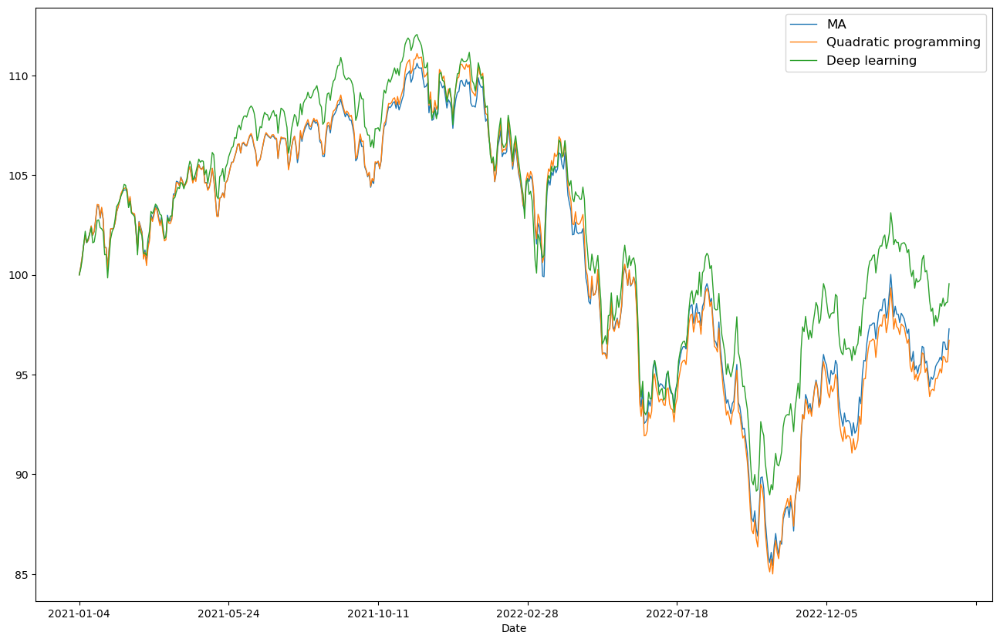

In [111]:
Position.plot()

# ------------------------------------------Thank you !!!!!------------------------------------------